## 🐈 End-to-End Multi-Class Cat-Breed Classification Reaches 93% Accuracy

In purpose of this project, I would like to train a model for various cat breed classification (13+) and try to predict my custom images.

This notebook builds an end-to-end muilti-class images classification using **TensorFlow 2.8.0**, and following is aspectation about project:

### 1. Problem expected to be solved

Identifying the breed of a cat given an image of a stranger cat.
When I sitting at anywhere and I take a piture of a lovely cat, I want to know what breed of cat it is. Furthermore, I also want the classifier to help me distinguish correct breed of a cat while crawling cat images from internet.

### 2. Source of Dataset

[**Source**]

The source of dataset in this project is from [Pop-Cats](https://www.kaggle.com/datasets/knucharat/pop-cats) of Kaggle Datasets. Moreover, the dataset consists of 20 popular cat breeds (Each class contains 500 images)。

[**Features**]

**Inputs**: We're dealing with images (unstructured data) so it's probably best we use deep learning/transfer learning.

**Outputs**: There are 20 breeds of dogs (this means there are 20 different classes).


| Breeds |     Images        |   Breeds   |     Images     | Breeds |     Images        |   Breeds   |     Images     |
|:----:|:---------------:|:--------:|:------------:|:----:|:---------------:|:--------:|:------------:|
|  **Abyssinian** | 501 | **American Curl** | 501 | **American Shorthair** | 500 |  **Bengal** | 501 |
| **Birman** | 502 | **Bombay** | 502 |  **British Shorthair** | 500 | **Egyptian Mau** | 501 |
|  **Exotic Shorthair** | 501 |  **Himalayan** | 501 | **Maine Coon** | 501 | **Manx** | 501 |
|  **Munchkin** | 501 | **Norwegian Forest** | 500 | **Persian** | 501 |  **Regdoll**  | 501 |
| **Russian Blue** | 501 | **Scottish Fold** | 501 | **Siamese** | 501 | **Sphynx** | 501 |
| Total number | 10019 |


There are around 10,000+ images in the dataset (these images have no labels), but images are not divided into training set and testing set, we have to separate it by myself.

The data structure of dataset:

```
Main-directory
  |
  |___Class_a_subdir(500 images)
  |________class_a_image_1
  |________class_a_image_2
  |
  |___Class_b_subdir(500 images)
  |________class_b_image_1
  |________class_b_image_2
  |
  |... (other 18 breeds)
```

### 3. Evaluation for classification

The evaluation of the classifier is at least 90% accuracy.



###  🛠 How do I complete the project?

1. Training model in 20% of cat-breeds images dataset for transfer learning model selection.

2. Training model in all cat-breeds images dataset to select the best of for further classification.

3. Training a basic model and save the model and fine-tuning the model for further increasing accuracy.

4. Analyzing training results and modifying model until perform the 90% accuracy.

5. Trying to predict my own images and apply it to crawling recognition.



## import essential modules

In [1]:
# import modules we need

# file operation
import os
import random
import pickle
from pathlib import Path
from datetime import datetime as dt
from dateutil.relativedelta import *

# data processing
import numpy as np
import pandas as pd

# neural network model
import tensorflow as tf

# data visualization
import seaborn as sns
import matplotlib as mpl
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
%matplotlib inline

# Import modules written by myself
from my_packages.data_processing.data_processor import DataProcessor, load_and_prep_image
from my_packages.model_training.model_trainer import ModelTrainer, load_labels, best_model_search

# Set root directory
root_dir = os.getcwd()

print(f"Curent working path: {root_dir}")
print(f"TensorFlow version: {tf.__version__}")

# Set global figure preferences
mpl.rc("axes", labelsize=14)
mpl.rc("xtick", labelsize=14)
mpl.rc("ytick", labelsize=14)
mpl.rc("font", size=14)


# Set local time
def time_now(hours=0):
  """
  Show the local time your server located at.

  Args:
    hours: If in colab environment, fill the time difference between other environment like colab server and your server.
  Return:
    datetime object.
  """
  return dt.now() + relativedelta(hours=hours)

# Record running time of notebook
print(f"Notebook is running at: {time_now()}")

Curent working path: c:\Users\User\Desktop\Data_Science_Notebook\Done__20_Cats_Project
TensorFlow version: 2.8.0
Notebook is running at: 2024-02-26 21:40:17.103082


## 1️⃣ >> Training model in 20% of cat-breeds images dataset.

I will train many models with a smaller dataset (200 images per each breed in training set and 50 images per each breed in testing set).

Models I use are the built-in models in [tf.keras.applications](https://www.tensorflow.org/api_docs/python/tf/keras/applications) APIs, I choose `VGG16`, `DenseNet`, `InceptionV3`, `ResNet50`, `ResNet101V2`, `InceptionResNetV2`, `Xception`, `MobileNet`, `MobileNetV2`, `EfficientNetB0`, and `EfficientNetV2B0` models to train datasets. However, I expect to choose several models that accuracy over specific threshold.

My training conditions

| Hyperparameters | Values |
| :-------------: | :----: |
| input shape | (224, 224, 3) |
| output shape | 20 (cat breeds) |
| activation function (last layer) | softmax |
| epochs | 5 |
| batch size | 32 |
| learning rate | 0.001 |
| loss function| categorical crossentropy |
| optimizer | Adam |

### Read data, split data, and visualize data

In [2]:
# Unzip file
print('In local:')
local_dir = os.path.join(root_dir, '20_cats_breeds.zip')
data_processor = DataProcessor(filename=local_dir)
data_processor.unzip_file()

In local:
Extract zip file completely from c:\Users\User\Desktop\Data_Science_Notebook\Done__20_Cats_Project\20_cats_breeds.zip.


In [3]:
# Set home directory
data_processor.set_home_path('./cats20')

# Set global variable
home_path = data_processor.home_path

Set home directory successfully as ./cats20


In [4]:
# Walk through data directory
number_of_images = data_processor.walk_through_dir()
print(f"Total number of images: {number_of_images}")

Dirpath: [./cats20] | Dirnumber: 20 | No image
Dirpath: [./cats20\Abyssinian] | No subdirectory | Filenumber:501
Dirpath: [./cats20\American Curl] | No subdirectory | Filenumber:501
Dirpath: [./cats20\American Shorthair] | No subdirectory | Filenumber:500
Dirpath: [./cats20\Bengal] | No subdirectory | Filenumber:501
Dirpath: [./cats20\Birman] | No subdirectory | Filenumber:502
Dirpath: [./cats20\Bombay] | No subdirectory | Filenumber:502
Dirpath: [./cats20\Bristish Shorthair] | No subdirectory | Filenumber:500
Dirpath: [./cats20\Egyptian Mau] | No subdirectory | Filenumber:501
Dirpath: [./cats20\Exotic Shorthair] | No subdirectory | Filenumber:501
Dirpath: [./cats20\Himalayan] | No subdirectory | Filenumber:501
Dirpath: [./cats20\Maine Coon] | No subdirectory | Filenumber:501
Dirpath: [./cats20\Manx] | No subdirectory | Filenumber:501
Dirpath: [./cats20\Munchkin] | No subdirectory | Filenumber:501
Dirpath: [./cats20\Norwegian Forest] | No subdirectory | Filenumber:500
Dirpath: [./cats2

In [5]:
# Get the class names
data_processor.get_class_names()
class_names = data_processor.class_names

There are 20 classes:
 ['Abyssinian', 'American Curl', 'American Shorthair', 'Bengal', 'Birman', 'Bombay', 'Bristish Shorthair', 'Egyptian Mau', 'Exotic Shorthair', 'Himalayan', 'Maine Coon', 'Manx', 'Munchkin', 'Norwegian Forest', 'Persian', 'Regdoll', 'Russian Blue', 'Scottish Fold', 'Siamese', 'Sphynx']


In [6]:
# read acceptable data
images_dict = data_processor.read_acceptable_data()

Not images: 1 in Abyssinian
Not images: 18 in American Curl
Not images: 1 in Bengal
Not images: 74 in Birman
Not images: 67 in Bombay
Not accepted by TensorFlow: 1 in Bombay
Not images: 45 in Bristish Shorthair
Not images: 130 in Egyptian Mau
Not images: 1 in Exotic Shorthair
Not images: 1 in Himalayan
Not images: 33 in Maine Coon
Not images: 2 in Manx
Not images: 135 in Munchkin
Not images: 41 in Persian
Not images: 96 in Regdoll
Not images: 52 in Russian Blue
Not images: 27 in Scottish Fold
Not images: 31 in Siamese
Not images: 93 in Sphynx
images_dict has been created.


In [7]:
# 501 --> 500
len(images_dict["Abyssinian"])

500

In [8]:
# Check content of dictionary
images_dict["Abyssinian"][0]

'cats20\\Abyssinian\\abys_0.jpg'

In [9]:
# Get images list of dataset
images = data_processor.get_images_list()

len(images)

9170

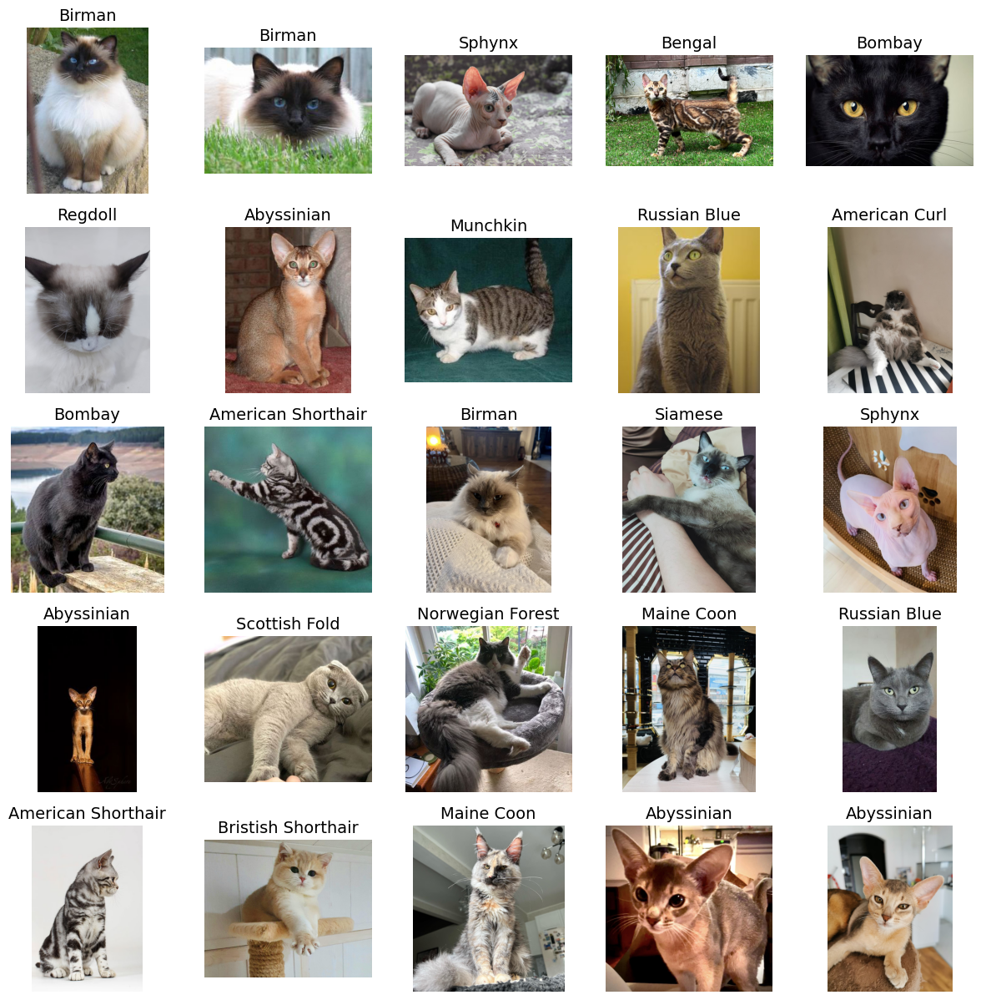

In [10]:
# Show 25 random images
data_processor.show_25_images_from_dataset()

In [11]:
# Set random seed
seed = 42
np.random.seed(seed=seed)

# Splitting train and test folders --> Working less data first
data_processor.create_train_test_folder(all_splitting=False)

./cats20\train has been created.
./cats20\test has been created.
Abyssinian images allocating...
Abyssinian images have been allocated.
--------------------------------------------------
American Curl images allocating...
American Curl images have been allocated.
--------------------------------------------------
American Shorthair images allocating...
American Shorthair images have been allocated.
--------------------------------------------------
Bengal images allocating...
Bengal images have been allocated.
--------------------------------------------------
Birman images allocating...
Birman images have been allocated.
--------------------------------------------------
Bombay images allocating...
Bombay images have been allocated.
--------------------------------------------------
Bristish Shorthair images allocating...
Bristish Shorthair images have been allocated.
--------------------------------------------------
Egyptian Mau images allocating...
Egyptian Mau images have been all

In [12]:
# Read data again
images_dict = data_processor.read_acceptable_data(train_test_split=True)

images_dict has been created.


In [13]:
# Check whether splitting successfully
random_cat = random.choice(list(images_dict.keys()))
print(f"{random_cat}: {len(images_dict[random_cat])}")

Persian: 250


In [14]:
# Collecting 250 images only for each breed (200 training data + 50 testing data)
images_list = data_processor.get_images_list()

len(images_list)

5000

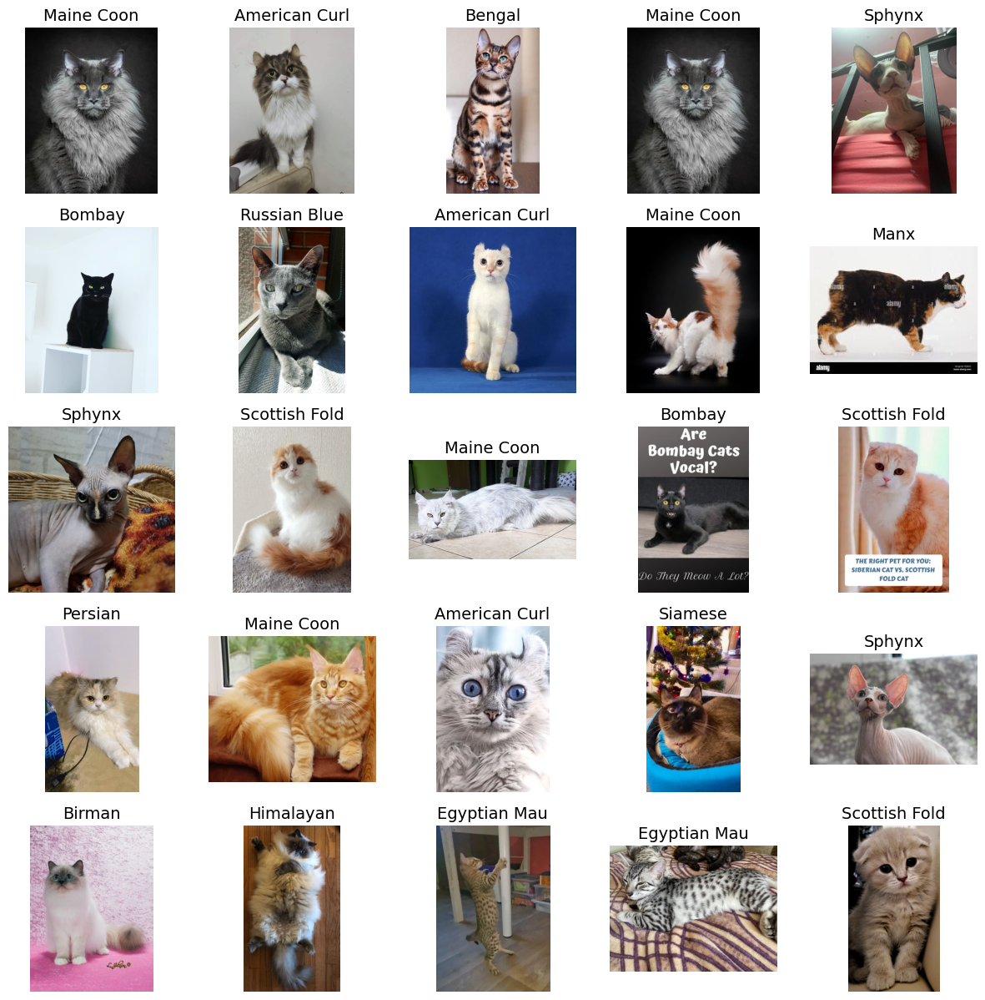

In [15]:
# Show 25 images again
data_processor.show_25_images_from_dataset()

### Create data batches from directory

Create training, validation, and testing datasets.

|               | Training data | Validation data | Testing data |
| ------------- | ------------- | --------------- | ------------ |
| Splitting Number (images) | 3600 (~72%) | 400 (~8%) | 1000 (10%) |

In [16]:
# # Set random seed
# seed = 42
# np.random.seed(seed=seed)

# # Create datasets
# train_data_batch, val_data_batch, test_data_batch = data_processor.create_data_batches_from_directory()

Found 4000 files belonging to 20 classes.
Using 3600 files for training.
Found 4000 files belonging to 20 classes.
Using 400 files for validation.
Found 1000 files belonging to 20 classes.


In [17]:
# train_data_batch.element_spec, val_data_batch.element_spec, test_data_batch.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)))

### Partial data: Find the best model

##### I use [tensorflow.keras.applications](https://www.tensorflow.org/api_docs/python/tf/keras/applications) APIs to load models to train less dataset, in this step I want to find several models performing better initially in following models:


> [VGG16](https://www.tensorflow.org/api_docs/python/tf/keras/applications/vgg16/VGG16): Models using several very **small (3x3) convolution filters** in architecture to significantly improve the performance of model that can be achieved by pushing the deeper weights layers (16-19 layers).

---
> [DenseNet121](https://www.tensorflow.org/api_docs/python/tf/keras/applications/densenet/DenseNet121): DenseNets resolve vanishing gradient by modifying the standard CNN architecture and simplifying the connectivity pattern between layers. In a DenseNet architecture, each layer is connected directly with every other layer, hence the name Densely Connected Convolutional Network. [Source](https://iq.opengenus.org/architecture-of-densenet121/)

---

> [InceptionV3](https://www.tensorflow.org/api_docs/python/tf/keras/applications/inception_v3/InceptionV3): Model uses three **Inception modules** (input shape: 299 * 299) with smaller convolution layers that three 3x3 filters replace one 7x7 filter in fist Inception module. Moreover, authors use **auxiliary classifiers** and **Label Smoothing Regularization (LSR)** instead of cross-entropy techniques in InceptionV3 to reduce overfitting.


---

> [ResNet50](https://www.tensorflow.org/api_docs/python/tf/keras/applications/resnet50/ResNet50) & [ResNet101V2](https://www.tensorflow.org/api_docs/python/tf/keras/applications/resnet_v2/ResNet101V2): Model contains more layers (more than one hundred layers) than Inception series (2x layers), ResNet model uses **Residual Learning** (Shortcut Connection, formula: $ H(x) = F(x) + x $) technique to solve the degradation of models with deeper layers. Moreover, the error rate in ImageNet of ResNet (3.6%) is less than human beings (5.1%).

---

> [InceptionResNetV2](https://www.tensorflow.org/api_docs/python/tf/keras/applications/inception_resnet_v2/InceptionResNetV2): The architecture of InceptionResNet model combines Inception model and ResNet model to achieve better performance, model contains **Stem module** for asymmetric convolution kernel of the pooling layer and convolution layer to reduce the amount of calculation without losing a large amount of feature information, **Inception-ResNet module** and **Reduction modules** for dimension reduction of feature map and performance improvement.
---

> [Xception](https://www.tensorflow.org/api_docs/python/tf/keras/applications/xception/Xception): **Xception** named as **Extreme Inception**, as the name suggests, it is the extreme of Inception. Model uses **depthwise separable convolution** operations (a depthwise convolution followed by
a pointwise convolution) to replace original Inception module, and the number of parameters are less than Inception's while achieving higher accuracy in ImageNet dataset.

---

> [MobileNet](https://www.tensorflow.org/api_docs/python/tf/keras/applications/mobilenet/MobileNet): Models of MobileNet-series are lightweight neural network using **Depthwise Separable Convolutional filter** technique containing **depthwise convolution** and **pointwise convolution** to replace original convolution filter resulting extremely decrease of parameter calculation (reduce calculation to be $ \frac{1}{N}+\frac{1}{D_{k}^{2}} $, N = number of output channel; D = Width of Depthwise convolution filter) despite slightly accuracy decreasing. Moreover, model introduce the **Width Mutiplier** (alpha) that reducing the input channel and output channel and **Resolution Multiplier** (Rho) that controlling the resolution of images to speed up computing time.

---

> [MobileNetV2](https://www.tensorflow.org/api_docs/python/tf/keras/applications/mobilenet_v2/MobileNetV2): Model introduces **Inverted residuals** and **Shortcut** techniques based on MobileNet model with **depthwise convolution**, **pointwise convolution**, and **Width Multiplier**. Originally, residual learning would reduce dimension of features through by a smaller filter (1x1) and then increase dimension of features, but relu activation will filter many important features while features being low-level dimension. To avoid that authors added an additional **depthwise convolution** layer for important features storage and increasing dimension of features in front of **Depthwise Separable Convolutional filter** with **ReLU6** activation function restricting output range, finally used **linear** activation instead of ReLU to avoid losing too many important deatures.

---

> [EfficientNetB0](https://www.tensorflow.org/api_docs/python/tf/keras/applications/efficientnet/EfficientNetB0): Authors rethink the balance of width, depth, and resolution of images on architecture of neural network models, based on this observation, authors uniformly scale up all dimension of width/depth/resolution using a simple yet highly effective **compound coefficient** leading to a better performance by scaling model arbitrarily called **model scaling** while being **8.4x smaller** and **6.1x faster** than existing ConvNet at 2020.

---

> [EfficientNetV2B0](https://www.tensorflow.org/api_docs/python/tf/keras/applications/efficientnet_v2/EfficientNetV2B0): Comparing to EfficientNet,  EfficientNetV2 using progressively adjusting image size and regularization during training to optimize the slow-training on large image size in EfficientNetV1, using the right combination of two building blocks, MBConv and Fused-MBConv to speed up the training time in early stages, and using a non-uniform scaling strategy to gradually add more layers to later stages to make training strategy more rational. Moreover, authors's experiments show that EfficientNetV2 models train faster and less parameters.

In [16]:
# Models
from tensorflow.keras.applications.efficientnet import EfficientNetB0
from tensorflow.keras.applications.efficientnet_v2 import EfficientNetV2B0
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.resnet_v2 import ResNet101V2
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.densenet import DenseNet121
from tensorflow.keras.applications.xception import Xception

# Data preprocessing
from tensorflow.keras.applications.efficientnet import preprocess_input as eff_preprocess_input
from tensorflow.keras.applications.efficientnet_v2 import preprocess_input as effv2_preprocess_input
from tensorflow.keras.applications.inception_resnet_v2 import preprocess_input as incep_res_v2_preprocess_input
from tensorflow.keras.applications.inception_v3 import preprocess_input as incepv3_preprocess_input
from tensorflow.keras.applications.mobilenet import preprocess_input as mobile_preprocess_input
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input as mobilev2_preprocess_input
from tensorflow.keras.applications.resnet50 import preprocess_input as res50_preprocess_input
from tensorflow.keras.applications.resnet_v2 import preprocess_input as resv2_preprocess_input
from tensorflow.keras.applications.vgg16 import preprocess_input as vgg16_preprocess_input
from tensorflow.keras.applications.densenet import preprocess_input as dens_preprocess_input
from tensorflow.keras.applications.xception import preprocess_input as xcep_preprocess_input

In [17]:
# Set images parameters
IMG_SIZE = data_processor.IMG_SIZE
INPUT_SHAPE = (IMG_SIZE, IMG_SIZE, 3)
BATCH_SIZE = data_processor.BATCH_SIZE
OUTPUT_SHAPE = len(class_names)

IMG_SIZE, INPUT_SHAPE, BATCH_SIZE, OUTPUT_SHAPE

(224, (224, 224, 3), 32, 20)

In [21]:
# { model_name: [model_object, preprocess] }
base_models = {
    'EfficientNetB0': [EfficientNetB0(include_top=False), eff_preprocess_input],
    'EfficientNetV2B0': [EfficientNetV2B0(include_top=False), effv2_preprocess_input],
    'InceptionResNetV2': [InceptionResNetV2(include_top=False), incep_res_v2_preprocess_input],
    'InceptionV3': [InceptionV3(include_top=False), incepv3_preprocess_input],
    'MobileNet': [MobileNet(include_top=False), mobile_preprocess_input],
    'MobileNetV2': [MobileNetV2(include_top=False), mobilev2_preprocess_input],
    'ResNet50': [ResNet50(include_top=False), res50_preprocess_input],
    'ResNet101V2': [ResNet101V2(include_top=False), resv2_preprocess_input],
    'VGG16': [VGG16(include_top=False), vgg16_preprocess_input],
    'DenseNet121': [DenseNet121(include_top=False), dens_preprocess_input],
    'Xception': [Xception(include_top=False), xcep_preprocess_input]
}

In [22]:
base_models

{'EfficientNetB0': [<keras.engine.functional.Functional at 0x1b52fd477f0>,
  <function keras.applications.efficientnet.preprocess_input(x, data_format=None)>],
 'EfficientNetV2B0': [<keras.engine.functional.Functional at 0x1b51f3d5cc0>,
  <function keras.applications.efficientnet_v2.preprocess_input(x, data_format=None)>],
 'InceptionResNetV2': [<keras.engine.functional.Functional at 0x1b51b1c77c0>,
  <function keras.applications.inception_resnet_v2.preprocess_input(x, data_format=None)>],
 'InceptionV3': [<keras.engine.functional.Functional at 0x1b531897370>,
  <function keras.applications.inception_v3.preprocess_input(x, data_format=None)>],
 'MobileNet': [<keras.engine.functional.Functional at 0x1b5170125f0>,
  <function keras.applications.mobilenet.preprocess_input(x, data_format=None)>],
 'MobileNetV2': [<keras.engine.functional.Functional at 0x1b517208310>,
  <function keras.applications.mobilenet_v2.preprocess_input(x, data_format=None)>],
 'ResNet50': [<keras.engine.functional.

In [23]:
# Set random seed
seed = 42
np.random.seed(seed=seed)

# Training info
model_histories = {}
model_scores = pd.DataFrame(index=['test_loss', 'test_accuracy'])

# { model_name: img_size }
input_imgs = {
    'DenseNet121': 224,
    'EfficientNetB0': 224,
    'EfficientNetV2B0': 224,
    'InceptionResNetV2': 299,
    'InceptionV3': 299,
    'MobileNet': 224,
    'MobileNetV2': 224,
    'ResNet50': 224,
    'ResNet101V2': 224, 
    'VGG16': 224,
    'Xception': 299
}

for model_name, img_size in input_imgs.items():
    # Create datasets
    train_data_batch, val_data_batch, test_data_batch = data_processor.create_data_batches_from_directory(IMG_SIZE=img_size)
    print(train_data_batch.element_spec, val_data_batch.element_spec, test_data_batch.element_spec)
    INPUT_SHAPE = (img_size, img_size, 3)
    print(f"INPUT_SHAPE {INPUT_SHAPE}")
    best_model_search(
        base_models,
        model_name,
        model_histories,
        model_scores,
        train_data_batch=train_data_batch,
        val_data_batch=val_data_batch,
        test_data_batch=test_data_batch,
        input_shape=INPUT_SHAPE,
        output_shape=OUTPUT_SHAPE,
        epochs=5)

Found 4000 files belonging to 20 classes.
Using 3600 files for training.
Found 4000 files belonging to 20 classes.
Using 400 files for validation.
Found 1000 files belonging to 20 classes.
(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)) (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)) (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 20), dtype=tf.float32, name=None))
INPUT_SHAPE (224, 224, 3)
DenseNet121 training starts...
Model: "DenseNet121"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 tf.math.truediv_5 (TFOpLamb  (None, 224, 224, 3)      0         
 da)               

### Results for partial dataset training

In [24]:
history_save_to = os.path.join(root_dir, 'partial_data_best_model_histories.pickle')
scores_save_to = os.path.join(root_dir, 'partial_data_test_scores.csv')

# Save history data
with open(history_save_to, 'wb') as handle:
  pickle.dump(model_histories, handle, protocol=pickle.HIGHEST_PROTOCOL)

# Model score dataframe
model_scores.to_csv(scores_save_to, sep=',')

In [25]:
# Read training history data
with open(history_save_to, 'rb') as handle:
  partial_data_model_histories = pickle.load(handle)

# Read model scores data
partial_data_test_scores = pd.read_csv(scores_save_to, index_col=0)
partial_data_test_scores.T.head()

,test_loss,test_accuracy
DenseNet121,0.736612,0.767
EfficientNetB0,0.655519,0.800
EfficientNetV2B0,0.666873,0.800
InceptionResNetV2,0.959675,0.704
InceptionV3,0.832685,0.737


Let's see the order of test scores evaluated by above models

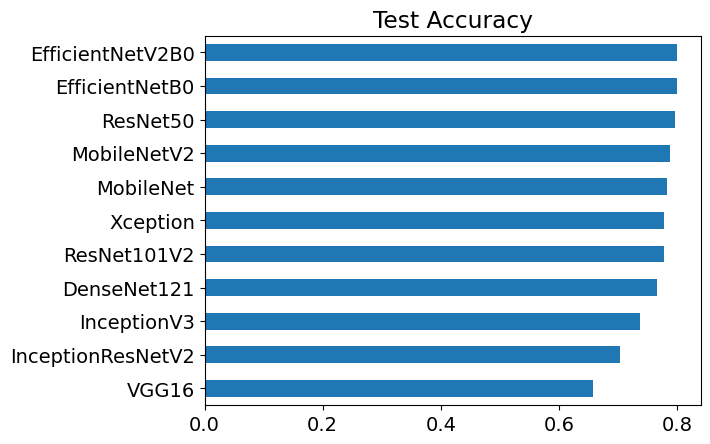

In [26]:
# Accuracy orders
partial_data_test_scores.T.test_accuracy.sort_values().plot.barh(title='Test Accuracy');

In [27]:
partial_data_test_scores.T.test_accuracy.describe()

count    11.000000
mean      0.762818
std       0.045407
min       0.658000
25%       0.752000
50%       0.778000
75%       0.793000
max       0.800000
Name: test_accuracy, dtype: float64

Further choose the models whose accuracy better than 75% (Q3) in all models.

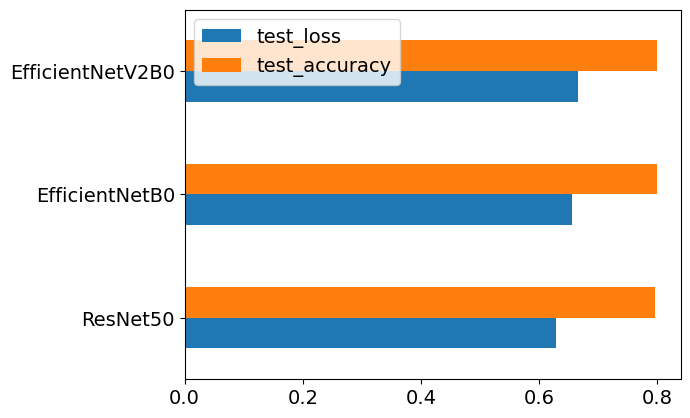

In [28]:
threshold = partial_data_test_scores.T.test_accuracy.describe()['75%']
partial_data_test_scores.T[partial_data_test_scores.T.test_accuracy > threshold].sort_values(by='test_accuracy').plot.barh()
plt.legend(loc='upper left')
plt.show()

Observe that `EfficientNetB0` and `EfficientNetV2B0` models are the best of all. However, the loss value of `ResNet50` is the highest of all so this model does not take into account. Let's check the loss values in case.

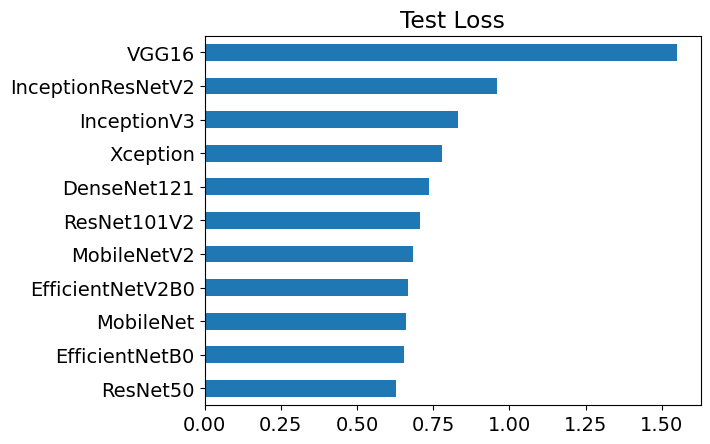

In [29]:
# Loss orders
partial_data_test_scores.T.test_loss.sort_values().plot.barh(title='Test Loss');

Among of all models, I recheck the loss values of `ResNet50`, `EfficientNetB0` and `EfficientNetV2B0` models are the lowest. Moreover, visualizing the training curves of these two models is necessary.

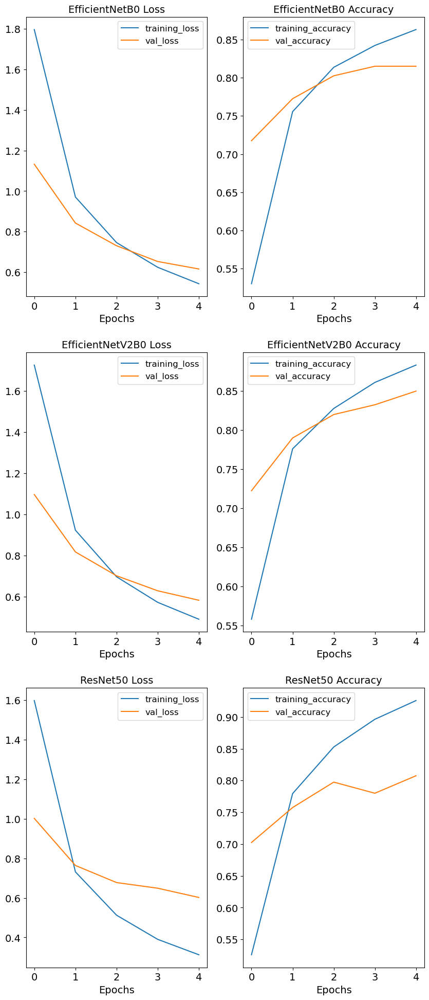

In [30]:
# Get data
partial_data_best_models = [partial_data_model_histories['EfficientNetB0'],
                            partial_data_model_histories['EfficientNetV2B0'],
                            partial_data_model_histories['ResNet50']]
partial_data_best_model_names = ['EfficientNetB0', 'EfficientNetV2B0', 'ResNet50']

# Plot figures
plt.figure(figsize=(10, 24))
iter_number = 1
for idx, history in enumerate(partial_data_best_models):

    # losses and accuracy
    loss = history["loss"]
    val_loss = history["val_loss"]
    accuracy = history["accuracy"]
    val_accuracy = history["val_accuracy"]

    # epochs
    epochs = range(len(history["loss"]))

    # plot loss and accuracy
    plt.subplot(3, 2, idx+iter_number)
    plt.plot(epochs, loss, label="training_loss")
    plt.plot(epochs, val_loss, label="val_loss")
    plt.title(f"{partial_data_best_model_names[idx]} Loss", fontsize=14)
    plt.xlabel("Epochs")
    plt.legend(fontsize=12)

    plt.subplot(3, 2, idx+iter_number+1)
    plt.plot(epochs, accuracy, label="training_accuracy")
    plt.plot(epochs, val_accuracy, label="val_accuracy")
    plt.title(f"{partial_data_best_model_names[idx]} Accuracy", fontsize=14)
    plt.xlabel("Epochs")
    plt.legend(fontsize=12);

    iter_number += 1

### ✨ **Observations** ✨

Combination of accuravy and loss curve we can see that EfficientNet series and ResNet model perform better.

Why the accuracy and loss curves of `EfficientNetB0` and `EfficientNetV2B0` perform better than others, the models of EfficientNet series is the latest models achieving higher top-1 accuracy on ImageNet than other models while being smaller and faster than existing ConvNet (referenced from [EfficientNet: Rethinking Model Scaling for Convolutional Neural Networks](https://arxiv.org/pdf/1905.11946.pdf)).

Why EfficientNet series models can achieve such an amazing achievement is that authors uniformly scale up all dimension of width/depth/resolution using a simple yet highly effective **compound coefficient** leading to a better performance by scaling model arbitrarily called **model scaling**.

However, the trends of loss curve show that these models are undergoing **overfitting**. Hence, the next step is training the full data to choose the best model ❗

## 2️⃣ >> Training model in full cat-breeds images dataset.

I will train many models with full dataset, models I use are the built-in models in [tf.keras.applications](https://www.tensorflow.org/api_docs/python/tf/keras/applications) APIs, I choose  `EfficientNetB0`, and `EfficientNetV2B0` models to train datasets. However, I will choose the best performance of model.

My training conditions

| Hyperparameters | Values |
| :-------------: | :----: |
| input shape | (224, 224, 3) |
| output shape | 20 (cat breeds) |
| activation function (last layer) | softmax |
| epochs | 5 |
| batch size | 32 |
| learning rate | 0.001 |
| loss function| categorical crossentropy |
| optimizer | Adam |

### Read data, split data, and visualize data

In [31]:
# Read photos that have not been moved yet
images_dict_before = data_processor.read_acceptable_data()

Not images: 1 in Abyssinian
Not images: 18 in American Curl
Not images: 1 in Bengal
Not images: 74 in Birman
Not images: 67 in Bombay
Not accepted by TensorFlow: 1 in Bombay
Not images: 45 in Bristish Shorthair
Not images: 130 in Egyptian Mau
Not images: 1 in Exotic Shorthair
Not images: 1 in Himalayan
Not images: 33 in Maine Coon
Not images: 2 in Manx
Not images: 135 in Munchkin
Not images: 41 in Persian
Not images: 96 in Regdoll
Not images: 52 in Russian Blue
Not images: 27 in Scottish Fold
Not images: 31 in Siamese
Not images: 93 in Sphynx
images_dict has been created.


In [32]:
# Check the images
random_cat_before = random.choice(list(images_dict_before.keys()))
print(f"{random_cat_before}: {len(images_dict_before[random_cat_before])}, {random.choice(images_dict_before[random_cat_before])}")

Sphynx: 158, cats20\Sphynx\sphynx_475.jpg


In [33]:
# Set random seed
seed = 42
np.random.seed(seed=seed)

# Splitting train and test folders --> Working full data
data_processor.create_train_test_folder(all_splitting=True)

./cats20\train folder is exists, go next!
./cats20\test folder is exists, go next!
Splitting directly!
Abyssinian images allocating...
Abyssinian images have been allocated.
--------------------------------------------------
Splitting directly!
American Curl images allocating...
American Curl images have been allocated.
--------------------------------------------------
Splitting directly!
American Shorthair images allocating...
American Shorthair images have been allocated.
--------------------------------------------------
Splitting directly!
Bengal images allocating...
Bengal images have been allocated.
--------------------------------------------------
Splitting directly!
Birman images allocating...
Birman images have been allocated.
--------------------------------------------------
Splitting directly!
Bombay images allocating...
Bombay images have been allocated.
--------------------------------------------------
Splitting directly!
Bristish Shorthair images allocating...
Bristis

In [34]:
# Read data again
images_dict = data_processor.read_acceptable_data(train_test_split=True)

images_dict has been created.


In [36]:
# Check whether splitting successfully
random_cat_after = random.choice(list(images_dict.keys()))
print(f"{random_cat_after}: {len(images_dict[random_cat_after])}, {random.choice(images_dict[random_cat_after])}")

Bengal: 500, cats20\train\Bengal\bengal_211.jpg


In [37]:
# Get images list of dataset
images = data_processor.get_images_list()

len(images)

9170

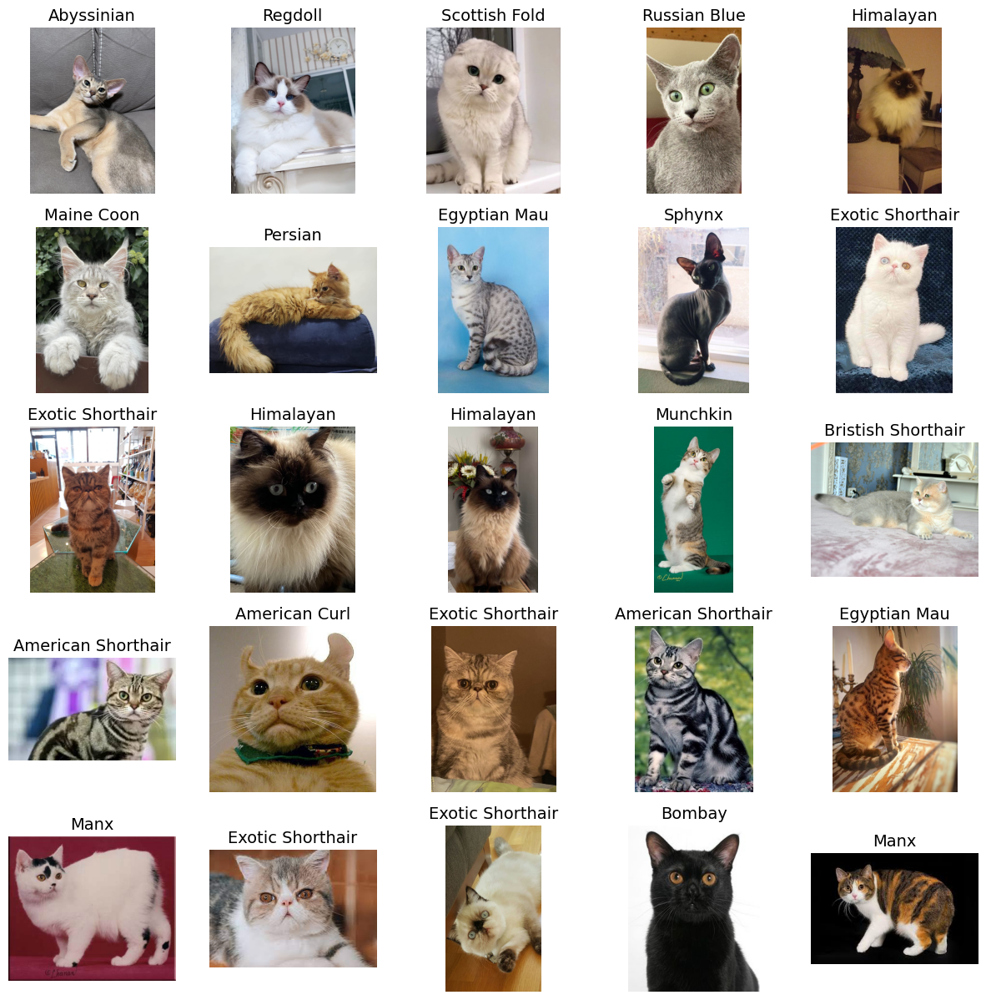

In [38]:
# Show 25 random images
data_processor.show_25_images_from_dataset()

### Create data batches from directory

Create training, validation, and testing datasets.

|               | Training data | Validation data | Testing data |
| ------------- | ------------- | --------------- | ------------ |
| Splitting Number (images) | 6453 (~70%) | 717 (~8%) | 2000 (~22%) |

In [39]:
# # Set random seed
# seed = 42
# np.random.seed(seed=seed)

# # Create datasets
# train_dataset, val_dataset, test_dataset = data_processor.create_data_batches_from_directory()

Found 7170 files belonging to 20 classes.
Using 6453 files for training.
Found 7170 files belonging to 20 classes.
Using 717 files for validation.
Found 2000 files belonging to 20 classes.


In [40]:
# train_dataset.element_spec, val_dataset.element_spec, test_dataset.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)))

### Full data: Find the best Model

In [39]:
# Set images parameters
IMG_SIZE = data_processor.IMG_SIZE
INPUT_SHAPE = (IMG_SIZE, IMG_SIZE, 3)
BATCH_SIZE = data_processor.BATCH_SIZE
OUTPUT_SHAPE = len(class_names)

IMG_SIZE, INPUT_SHAPE, BATCH_SIZE, OUTPUT_SHAPE

(224, (224, 224, 3), 32, 20)

In [40]:
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.efficientnet import EfficientNetB0
from tensorflow.keras.applications.efficientnet_v2 import EfficientNetV2B0

from tensorflow.keras.applications.efficientnet import preprocess_input as eff_preprocess_input
from tensorflow.keras.applications.efficientnet_v2 import preprocess_input as effv2_preprocess_input
from tensorflow.keras.applications.resnet50 import preprocess_input as res50_preprocess_input

In [41]:
# { model_name: [model_object, preprocess] }
full_data_base_models = {
    'EfficientNetB0': [EfficientNetB0(include_top=False), eff_preprocess_input],
    'EfficientNetV2B0': [EfficientNetV2B0(include_top=False), effv2_preprocess_input],
    'ResNet50': [ResNet50(include_top=False), res50_preprocess_input]
}

# { model_name: img_size }
full_data_input_imgs = {
    'EfficientNetB0': 224,
    'EfficientNetV2B0': 224,
    'ResNet50': 224
}

full_data_models_histories = {}
full_data_models_scores = pd.DataFrame(index=['test_loss', 'test_accuracy'])

# Set random seed
seed = 42
np.random.seed(seed=seed)

for model_name, img_size in full_data_input_imgs.items():
    # Create datasets
    train_data_batch, val_data_batch, test_data_batch = data_processor.create_data_batches_from_directory(IMG_SIZE=img_size)
    print(train_data_batch.element_spec, val_data_batch.element_spec, test_data_batch.element_spec)
    INPUT_SHAPE = (img_size, img_size, 3)
    print(f"INPUT_SHAPE {INPUT_SHAPE}")
    best_model_search(
        full_data_base_models,
        model_name,
        full_data_models_histories,
        full_data_models_scores,
        train_data_batch=train_data_batch,
        val_data_batch=val_data_batch,
        test_data_batch=test_data_batch,
        input_shape=INPUT_SHAPE,
        output_shape=OUTPUT_SHAPE)

Found 7170 files belonging to 20 classes.
Using 6453 files for training.
Found 7170 files belonging to 20 classes.
Using 717 files for validation.
Found 2000 files belonging to 20 classes.
(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)) (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)) (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 20), dtype=tf.float32, name=None))
INPUT_SHAPE (224, 224, 3)
EfficientNetB0 training starts...
Model: "EfficientNetB0"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetb0 (Functional)  (None, None, None, 1280)  4049571  
             

In [42]:
# Check full data historys
len(full_data_models_histories.keys()), len(full_data_models_histories.values())

(3, 3)

In [43]:
# Check test scores
full_data_models_scores

,EfficientNetB0,EfficientNetV2B0,ResNet50
test_loss,0.571071,0.547255,0.598925
test_accuracy,0.826500,0.832000,0.818000


### Results for full dataset training

In [44]:
full_data_history_save_to = os.path.join(root_dir, 'full_data_best_model_histories.pickle')
full_data_scores_save_to = os.path.join(root_dir, 'full_data_best_model_scores.csv')

# Save history data
with open(full_data_history_save_to, 'wb') as handle:
  pickle.dump(full_data_models_histories, handle, protocol=pickle.HIGHEST_PROTOCOL)

# Save Model score dataframe
full_data_models_scores.to_csv(full_data_scores_save_to, sep=',')

In [45]:
# Read training history data
full_data_history_save_to = os.path.join(root_dir, 'full_data_best_model_histories.pickle')

with open(full_data_history_save_to, 'rb') as handle:
  full_data_best_model_histories = pickle.load(handle)

full_data_scores_save_to = os.path.join(root_dir, 'full_data_best_model_scores.csv')
full_data_test_scores = pd.read_csv(full_data_scores_save_to, index_col=0)

full_data_test_scores

,EfficientNetB0,EfficientNetV2B0,ResNet50
test_loss,0.571071,0.547255,0.598925
test_accuracy,0.826500,0.832000,0.818000


Let's see the order of test scores evaluated by above models

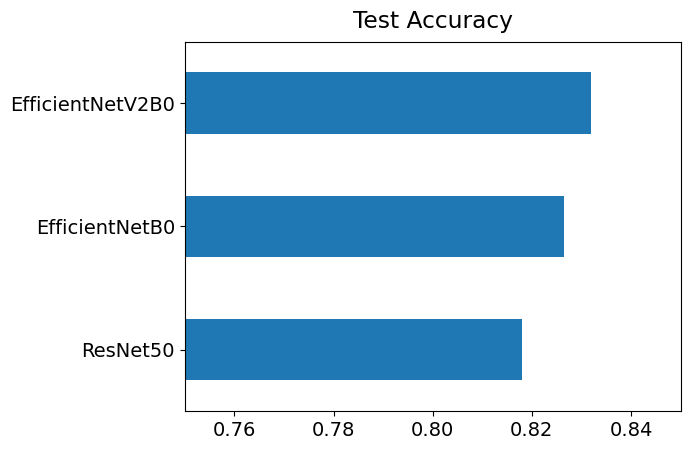

In [46]:
full_data_test_scores.T.test_accuracy.sort_values().plot.barh()
plt.xlim([0.75, 0.85])
plt.title('Test Accuracy', pad=10)
plt.show()

Let's see the order of test scores evaluated by above models

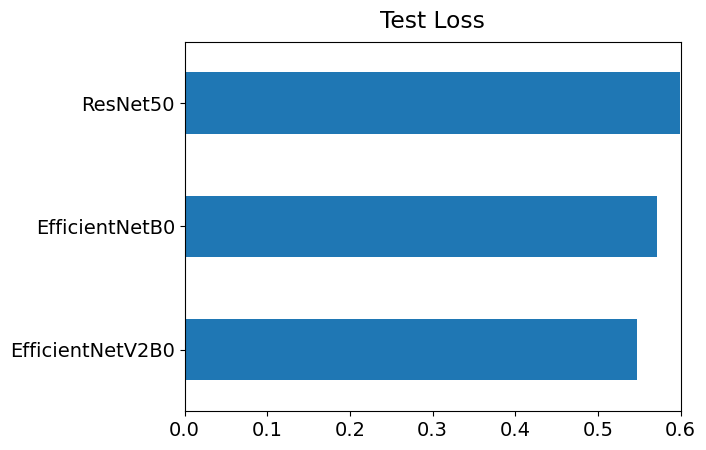

In [47]:
full_data_test_scores.T.test_loss.sort_values().plot.barh()
plt.xlim([0, 0.6])
plt.title('Test Loss', pad=10)
plt.show()

Show loss curves of models.

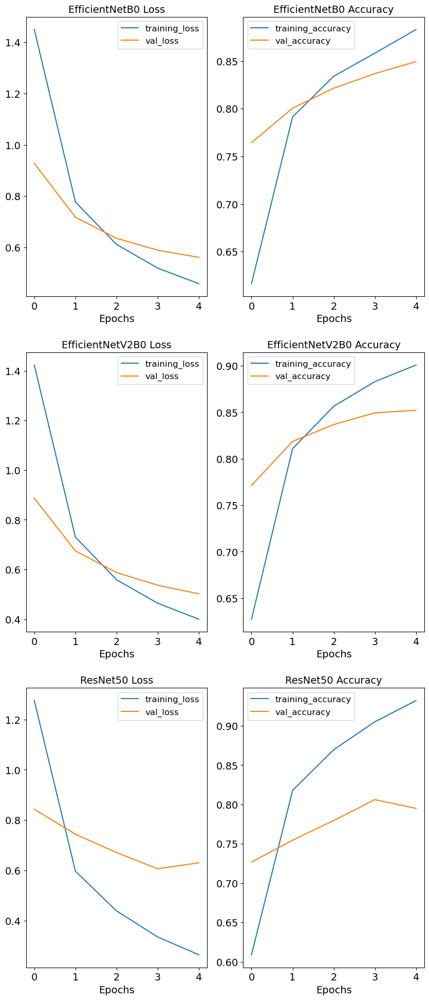

In [48]:
# Get data
full_data_best_model_names = ['EfficientNetB0', 'EfficientNetV2B0', 'ResNet50']

# Plot figures
plt.figure(figsize=(10, 24))
iter_number = 1
for idx, history in enumerate(full_data_best_model_histories.values()):

    # losses and accuracy
    loss = history["loss"]
    val_loss = history["val_loss"]
    accuracy = history["accuracy"]
    val_accuracy = history["val_accuracy"]

    # epochs
    epochs = range(len(history["loss"]))

    # plot loss and accuracy
    plt.subplot(3, 2, idx+iter_number)
    plt.plot(epochs, loss, label="training_loss")
    plt.plot(epochs, val_loss, label="val_loss")
    plt.title(f"{full_data_best_model_names[idx]} Loss", fontsize=14)
    plt.xlabel("Epochs")
    plt.legend(fontsize=12)

    plt.subplot(3, 2, idx+iter_number+1)
    plt.plot(epochs, accuracy, label="training_accuracy")
    plt.plot(epochs, val_accuracy, label="val_accuracy")
    plt.title(f"{full_data_best_model_names[idx]} Accuracy", fontsize=14)
    plt.xlabel("Epochs")
    plt.legend(fontsize=12);

    iter_number += 1

### ✨ **Observations** ✨

The results suggest that both models still undergoing **overfitting** means a better performance on training dataset but not in testing dataset. However, in terms of accuracy, `EfficientNetV2B0` is slightly better than `EfficientNetB0`, it seems not to be a significant difference, in other hands, `EfficientNetV2B0` trains faster than `EfficientNetB0`, it probably due to the optimization on progressively adjusting image size, regularization and modification of MBConv to improve the shortcoming of `EfficientNetB0` (referenced from [EfficientNetV2: Smaller Models and Faster Training](https://arxiv.org/pdf/2104.00298.pdf)). 

Hence, I choose `EfficientNetV2B0` model to perform subsequent fine-tuning adjustments. Moreover, I will use **data augmentation** and **fine-tuning** techniques to reduce overfitting and increase accuracy.

## 3️⃣ >> Training a basic model for further fine-tuning.

In this part, I will use `EfficientNetV2B0` model to train full dataset with **data augmentation** and **parameters fine-tuning** technique trying to achieve at least 90% accuracy. Moreover, I will also creating a `ModelCheckpoint` callback, the [`ModelCheckpoint`](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/ModelCheckpoint) callback gives me the ability to save my model, as a whole in the [`SavedModel`](https://www.tensorflow.org/tutorials/keras/save_and_load#save_the_entire_model) format or the [weights (patterns) only](https://www.tensorflow.org/tutorials/keras/save_and_load#manually_save_weights) to a specified directory as it trains.

This is helpful while my model is going to be training for a long time and I want to make backups of it as it trains, if my model needs to be trained for longer, I can reload it from a specific checkpoint and continue training from there.

For example, originally I can only fit my model for 5 epochs and check the training curves, furthermore, I can see it is still improving by doing fine-tuning operation for another 5 epochs after reloading the checkpoint, unfreeze some (or all) of the base model layers and then continue training.


My augmentation conditions
1. Random Flip: **horizontal**
2. Random Rotation: **0.2**
3. Random Zoom: **0.2**
4. Random Height: **0.2**
5. Random Width: **0.2**
6. Random Contrast: **0.5**


My training conditions

| Hyperparameters | Values |
| :-------------: | :----: |
| input shape | (224, 224, 3) |
| output shape | 20 (cat breeds) |
| activation function (last layer) | softmax |
| epochs for **training** | 5 |
| epochs for **fine-tune** | 5 |
| batch size | 32 |
| learning rate for **training** | $10^{-3}$ |
| learning rate for **fine-tunie** | $10^{-4}$ |
| loss function| categorical crossentropy |
| optimizer | Adam |

### Basic model training

Found 7170 files belonging to 20 classes.
Using 6453 files for training.
Found 7170 files belonging to 20 classes.
Using 717 files for validation.
Found 2000 files belonging to 20 classes.
(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)) (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 20), dtype=tf.float32, name=None)) (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 20), dtype=tf.float32, name=None))
Image size: 224
Input shape: (224, 224, 3)
output shape: 20



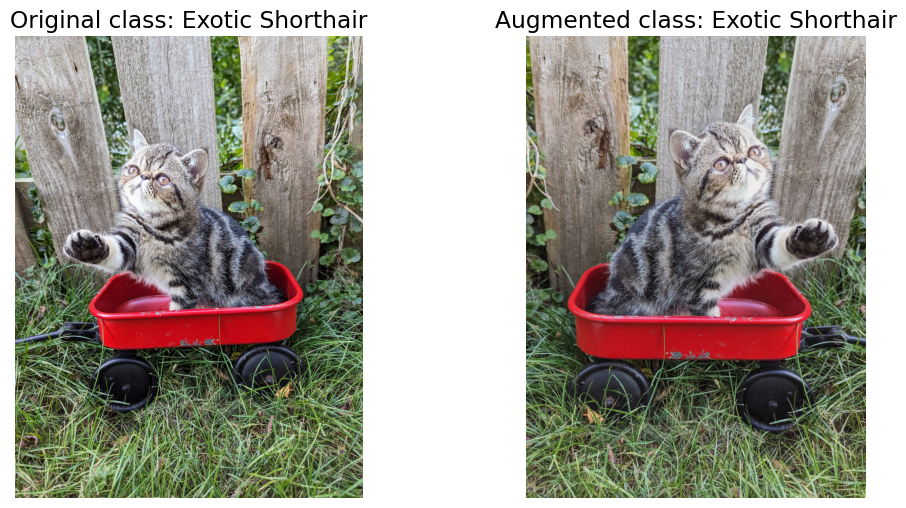


Model: "EfficientNetV2B0"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer_0 (InputLayer)  [(None, 224, 224, 3)]     0         
                                                                 
 data_augmentation_0 (Sequen  (None, 224, 224, 3)      0         
 tial)                                                           
                                                                 
 efficientnetv2-b0 (Function  (None, None, None, 1280)  5919312  
 al)                                                             
                                                                 
 global_average_pooling_0 (G  (None, 1280)             0         
 lobalAveragePooling2D)                                          
                                                                 
 output_layer_0 (Dense)      (None, 20)                25620     
                                                 

In [5]:
# Train checkpoint model
from my_packages.model_training.model_trainer import ModelTrainer
from tensorflow.keras.applications.efficientnet_v2 import EfficientNetV2B0
from tensorflow.keras.applications.efficientnet_v2 import preprocess_input as effv2_preprocess_input

# Create batch dataset
img_size = data_processor.IMG_SIZE
train_dataset, val_dataset, test_dataset = data_processor.create_data_batches_from_directory(IMG_SIZE=img_size)
print(train_dataset.element_spec, val_dataset.element_spec, test_dataset.element_spec)

# Count model
handle_number = 0

# Create model trainer object
model_trainer = ModelTrainer(
    IMG_SIZE=img_size,
    train_dataset=train_dataset,
    val_dataset=val_dataset,
    test_dataset=test_dataset,
    classes=len(class_names),
    handle_number=handle_number)
print()
# show image after augmentation

# Choose image
images_list = data_processor.get_images_list()
random_image_path = random.choice(images_list)
target_class = random_image_path.split('\\')[-2]

# Output image
plt.figure(figsize=(12, 6))
plt.subplot(121)
img = mpimg.imread(random_image_path)
plt.imshow(img)
plt.title(f"Original class: {target_class}")
plt.axis("off")

# The format after augmentation must be (None, height, width, 3)
plt.subplot(122)
data_augmentation = model_trainer._data_augmentation()
augmented_img = data_augmentation(tf.expand_dims(img, axis=0), training=True)
plt.imshow(tf.squeeze(augmented_img) / 255.) # normalization
plt.title(f"Augmented class: {target_class}")
plt.axis("off")
plt.show()
print()

# Build model
base_model = EfficientNetV2B0(include_top=False)
model = model_trainer.build_model(base_model=base_model, preprocess_input=effv2_preprocess_input, model_name='EfficientNetV2B0')

# Set checkpoint path
checkpoint_path = model_trainer.set_checkpoint(os.path.join(root_dir, 'basic_model_checkpoints_weights.h5'))

# Fit and evaluate model
model_trainer.compile()
model_history = model_trainer.fit_model(epochs=5)
model_results = model_trainer.evaluate_model()
handle_number += 1

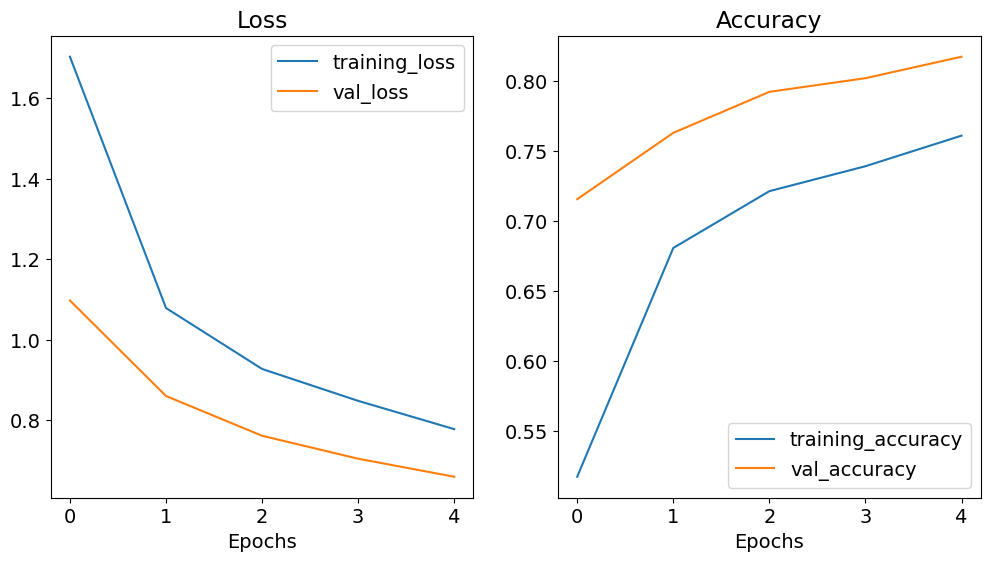

In [6]:
model_trainer.plot_loss_curves()

### Fine-tuning for 5% parameters

It is essential to recompile model after fine-tuning.

In [7]:
# Fine-tuning model for 5% parameters
model_trainer.fine_tune_model_layers(fine_tune_ratio=0.05)

# Recompile is necessary after fine-tuning
model_trainer.compile(optimizer=tf.keras.optimizers.Adam(1e-4))

# Fir the model
fine_tune_model_history = model_trainer.fit_model(epochs=10, fine_tune_epochs=5)

# Evaluate the model
fine_tune_model_results = model_trainer.evaluate_model()
print(fine_tune_model_results)
handle_number += 1

Change last 12 layers of efficientnetv2-b0 successfully, please recompile model again.
Epoch 6/10


202/202 [==============================] - ETA: 0s - loss: 0.6801 - accuracy: 0.7781
Epoch 6: val_accuracy improved from 0.81729 to 0.83821, saving model to c:\Users\User\Desktop\Data_Science_Notebook\Done__20_Cats_Project\basic_model_checkpoints_weights.h5
202/202 [==============================] - 342s 2s/step - loss: 0.6801 - accuracy: 0.7781 - val_loss: 0.5513 - val_accuracy: 0.8382
Epoch 7/10
202/202 [==============================] - ETA: 0s - loss: 0.6164 - accuracy: 0.7987
Epoch 7: val_accuracy improved from 0.83821 to 0.84519, saving model to c:\Users\User\Desktop\Data_Science_Notebook\Done__20_Cats_Project\basic_model_checkpoints_weights.h5
202/202 [==============================] - 325s 2s/step - loss: 0.6164 - accuracy: 0.7987 - val_loss: 0.5268 - val_accuracy: 0.8452
Epoch 8/10
202/202 [==============================] - ETA: 0s - loss: 0.5891 - accuracy: 0.8086
Epoch 8: val_accuracy improved from 0.84519 to 0.85077, saving model to c:\Users\User\Desktop\Data_Science_Notebo

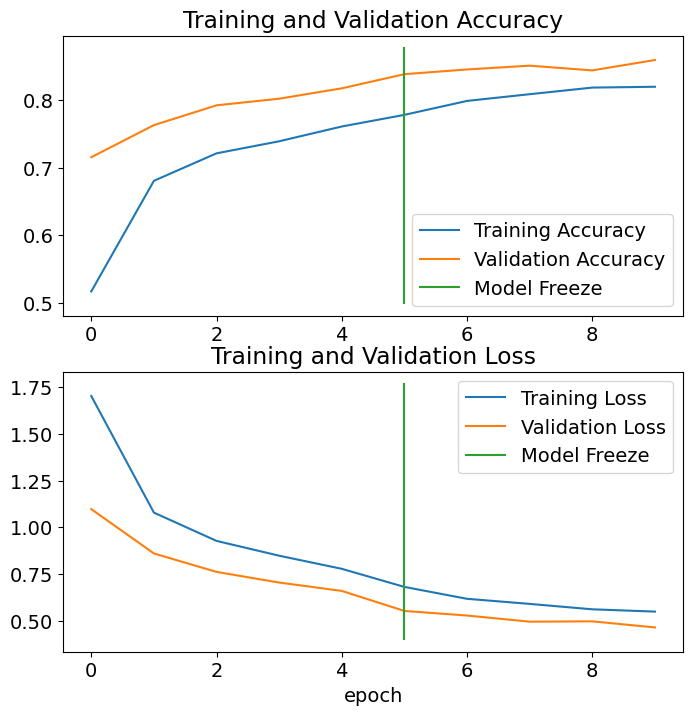

In [8]:
# Plot the results containing previous one
model_trainer.compare_historys()

As you can see that the accuracy is improving up to 80%, but it is still far from 90%. However, let's see what the wrong predictions are and try to do something for further experiments.

In [9]:
# Get the probability of predicitons
pred_probs = model_trainer.model.predict(model_trainer.test_dataset, verbose=1)

pred_probs[:3]

63/63 [==============================] - 67s 1s/step


array([[9.9976557e-01, 9.0641754e-07, 5.5413138e-06, 1.6931332e-06,
        8.9864942e-11, 6.4194262e-07, 4.6783293e-06, 1.2327748e-06,
        5.3455665e-08, 5.1203386e-12, 1.6961359e-08, 1.3285691e-06,
        6.3458174e-07, 1.5209056e-11, 1.5100700e-10, 2.3552532e-10,
        2.1597097e-04, 6.8336584e-07, 6.2619385e-08, 1.0846236e-06],
       [9.9540013e-01, 5.2289947e-06, 2.0649638e-07, 1.3038093e-05,
        2.6200661e-07, 1.4866309e-08, 2.1881131e-03, 1.6892479e-03,
        5.2505216e-06, 4.2994304e-07, 1.0131549e-05, 1.8314870e-05,
        6.0524988e-05, 3.2387284e-06, 5.6666036e-06, 8.0599409e-07,
        5.2416639e-04, 5.6238305e-06, 6.8778529e-05, 9.3841766e-07],
       [9.9851817e-01, 2.0623158e-07, 4.5037321e-08, 1.5352990e-06,
        1.0277468e-09, 1.1091482e-05, 1.0771913e-04, 1.2950547e-07,
        5.4619986e-06, 5.9567391e-09, 8.8343901e-09, 4.3183438e-05,
        5.2782783e-04, 1.2376651e-09, 1.2469873e-08, 4.6688346e-08,
        3.4338908e-04, 3.6087629e-06, 4.375124

In [10]:
# Get the class names model predicted
pred_classes = pred_probs.argmax(axis=1)

pred_classes[:10]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int64)

In [11]:
# Get the real labels
y_labels_indexes = []
for images, label in model_trainer.test_dataset.unbatch():
  y_labels_indexes.append(label.numpy().argmax())
y_labels_indexes[:10]

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

In [12]:
class_names_model = model_trainer.test_dataset.class_names

class_names_model

['Abyssinian',
 'American Curl',
 'American Shorthair',
 'Bengal',
 'Birman',
 'Bombay',
 'Bristish Shorthair',
 'Egyptian Mau',
 'Exotic Shorthair',
 'Himalayan',
 'Maine Coon',
 'Manx',
 'Munchkin',
 'Norwegian Forest',
 'Persian',
 'Regdoll',
 'Russian Blue',
 'Scottish Fold',
 'Siamese',
 'Sphynx']

In [13]:
# Get the filepath of testing images
filepaths = []
for filepath in model_trainer.test_dataset.list_files(
    './cats20/test/*/*.jpg',
    shuffle=False):
  filepaths.append(filepath.numpy())
filepaths[:10]

[b'.\\cats20\\test\\Abyssinian\\abys_112.jpg',
 b'.\\cats20\\test\\Abyssinian\\abys_117.jpg',
 b'.\\cats20\\test\\Abyssinian\\abys_128.jpg',
 b'.\\cats20\\test\\Abyssinian\\abys_139.jpg',
 b'.\\cats20\\test\\Abyssinian\\abys_14.jpg',
 b'.\\cats20\\test\\Abyssinian\\abys_145.jpg',
 b'.\\cats20\\test\\Abyssinian\\abys_147.jpg',
 b'.\\cats20\\test\\Abyssinian\\abys_148.jpg',
 b'.\\cats20\\test\\Abyssinian\\abys_154.jpg',
 b'.\\cats20\\test\\Abyssinian\\abys_156.jpg']

In [14]:
# Create a dataframe containing useful information for analysis
pred_df = pd.DataFrame({
    "img_path": filepaths,
    "y_true": y_labels_indexes,
    "y_pred": pred_classes,
    "pred_conf": pred_probs.max(axis=1), # get the maximum prediction probability value
    "y_true_classname": [class_names_model[i] for i in y_labels_indexes],
    "y_pred_classname": [class_names_model[i] for i in pred_classes]})
pred_df.head()

,img_path,y_true,y_pred,pred_conf,y_true_classname,y_pred_classname
0,b'.\\cats20\\test\\Abyssinian\\abys_112.jpg',0,0,0.999766,Abyssinian,Abyssinian
1,b'.\\cats20\\test\\Abyssinian\\abys_117.jpg',0,0,0.995400,Abyssinian,Abyssinian
2,b'.\\cats20\\test\\Abyssinian\\abys_128.jpg',0,0,0.998518,Abyssinian,Abyssinian
3,b'.\\cats20\\test\\Abyssinian\\abys_139.jpg',0,0,0.999987,Abyssinian,Abyssinian
4,b'.\\cats20\\test\\Abyssinian\\abys_14.jpg',0,0,0.990177,Abyssinian,Abyssinian


In [15]:
# Is the prediction correct?
pred_df["pred_correct"] = pred_df["y_true"] == pred_df["y_pred"]
pred_df.head()

,img_path,y_true,y_pred,pred_conf,y_true_classname,y_pred_classname,pred_correct
0,b'.\\cats20\\test\\Abyssinian\\abys_112.jpg',0,0,0.999766,Abyssinian,Abyssinian,True
1,b'.\\cats20\\test\\Abyssinian\\abys_117.jpg',0,0,0.995400,Abyssinian,Abyssinian,True
2,b'.\\cats20\\test\\Abyssinian\\abys_128.jpg',0,0,0.998518,Abyssinian,Abyssinian,True
3,b'.\\cats20\\test\\Abyssinian\\abys_139.jpg',0,0,0.999987,Abyssinian,Abyssinian,True
4,b'.\\cats20\\test\\Abyssinian\\abys_14.jpg',0,0,0.990177,Abyssinian,Abyssinian,True


In [16]:
# Get the wrong examples
wrong_preds = pred_df[pred_df["pred_correct"] == False].sort_values("pred_conf", ascending=False)
wrong_preds

,img_path,y_true,y_pred,pred_conf,y_true_classname,y_pred_classname,pred_correct
446,b'.\\cats20\\test\\Birman\\birman_31.jpg',4,9,0.992649,Birman,Himalayan,False
473,b'.\\cats20\\test\\Birman\\birman_421.jpg',4,9,0.992649,Birman,Himalayan,False
447,b'.\\cats20\\test\\Birman\\birman_314.jpg',4,9,0.989092,Birman,Himalayan,False
1802,b'.\\cats20\\test\\Siamese\\siamese_121.jpg',18,15,0.974291,Siamese,Regdoll,False
1294,b'.\\cats20\\test\\Munchkin\\munchkin_56.jpg',12,5,0.972877,Munchkin,Bombay,False
...,...,...,...,...,...,...,...
517,b'.\\cats20\\test\\Bombay\\bombay_167.jpg',5,6,0.274915,Bombay,Bristish Shorthair,False
1166,b'.\\cats20\\test\\Manx\\manx_400.jpg',11,1,0.253865,Manx,American Curl,False
804,b'.\\cats20\\test\\Exotic Shorthair\\exotic_12...,8,17,0.250809,Exotic Shorthair,Scottish Fold,False
175,b'.\\cats20\\test\\American Curl\\americancurl...,1,13,0.249968,American Curl,Norwegian Forest,False


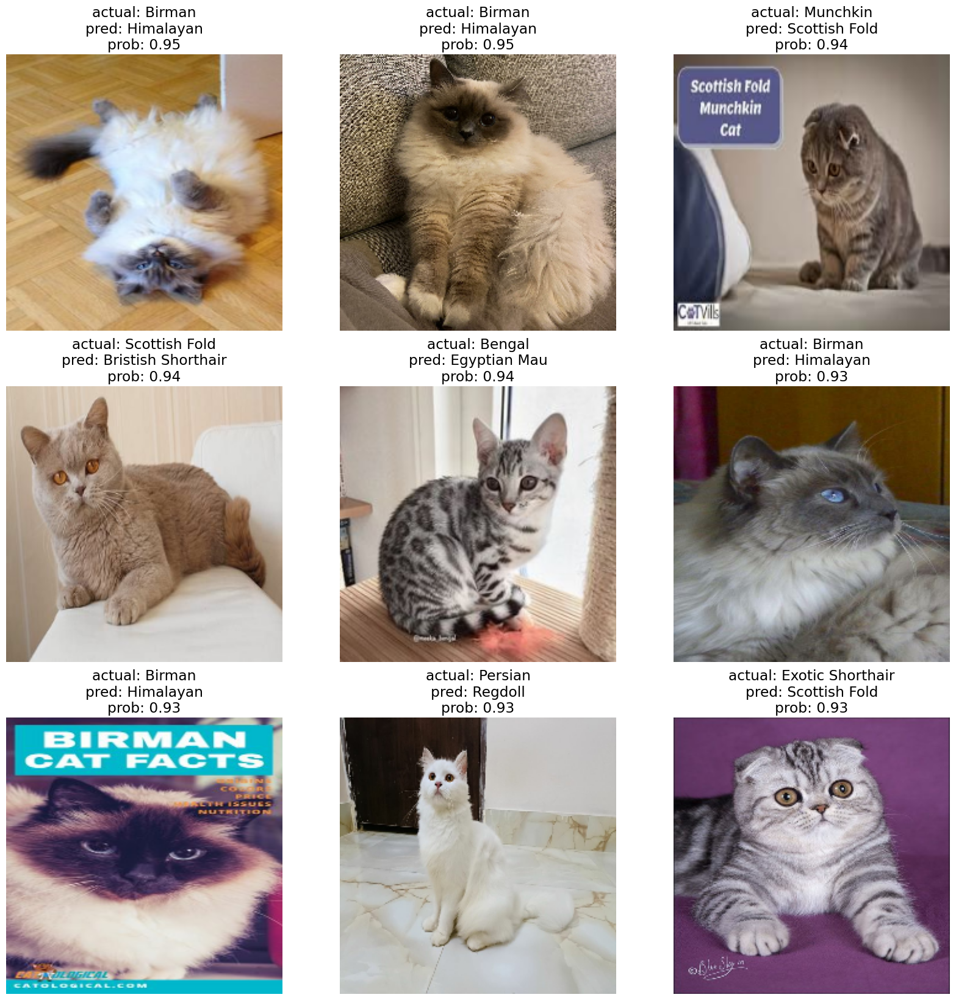

In [17]:
# Visualize some of the most wrong examples
images_to_view = 9
start_index = 10 # change the start index to view more
plt.figure(figsize=(20, 20))
for i, row in enumerate(wrong_preds[start_index:start_index+images_to_view].itertuples()):
  plt.subplot(3, 3, i+1)
  img = load_and_prep_image(row[1], scale=True)
  _, _, _, _, pred_prob, y_true, y_pred, _ = row # only interested in a few parameters of each row
  plt.imshow(img)
  plt.title(f"actual: {y_true}\npred: {y_pred}\nprob: {pred_prob:.2f}")
  plt.axis(False)

In [18]:
# Save the dataframe
wrong_preds.to_csv(os.path.join(root_dir, 'wrong_predictions.csv'))

In [19]:
wrong_preds_df = pd.read_csv(os.path.join(root_dir, 'wrong_predictions.csv'), index_col=0)

wrong_preds_df.head()

,img_path,y_true,y_pred,pred_conf,y_true_classname,y_pred_classname,pred_correct
446,b'.\\cats20\\test\\Birman\\birman_31.jpg',4,9,0.992649,Birman,Himalayan,False
473,b'.\\cats20\\test\\Birman\\birman_421.jpg',4,9,0.992649,Birman,Himalayan,False
447,b'.\\cats20\\test\\Birman\\birman_314.jpg',4,9,0.989092,Birman,Himalayan,False
1802,b'.\\cats20\\test\\Siamese\\siamese_121.jpg',18,15,0.974291,Siamese,Regdoll,False
1294,b'.\\cats20\\test\\Munchkin\\munchkin_56.jpg',12,5,0.972877,Munchkin,Bombay,False


### Find incorrect predictions

In [20]:
unique_labels = np.unique(wrong_preds_df.y_true_classname)

unique_labels

array(['Abyssinian', 'American Curl', 'American Shorthair', 'Bengal',
       'Birman', 'Bombay', 'Bristish Shorthair', 'Egyptian Mau',
       'Exotic Shorthair', 'Himalayan', 'Maine Coon', 'Manx', 'Munchkin',
       'Norwegian Forest', 'Persian', 'Regdoll', 'Russian Blue',
       'Scottish Fold', 'Siamese', 'Sphynx'], dtype=object)

In [21]:
# Find error number of predictions
incorrect_labels = {}
for label in unique_labels:
  sum_of_error = wrong_preds_df[wrong_preds_df.y_true_classname == label].y_pred_classname.value_counts().sum()
  incorrect_labels[label] = sum_of_error


error_predictions_df = pd.DataFrame(incorrect_labels, index=['number_of_error'])
error_predictions_df.T

,number_of_error
Abyssinian,4
American Curl,34
American Shorthair,6
Bengal,15
Birman,35
Bombay,2
Bristish Shorthair,11
Egyptian Mau,6
Exotic Shorthair,14
Himalayan,11


In [22]:
error_predictions_df.T.describe()

,number_of_error
count,20.000000
mean,15.700000
std,13.215222
min,1.000000
25%,6.000000
50%,11.000000
75%,22.000000
max,44.000000


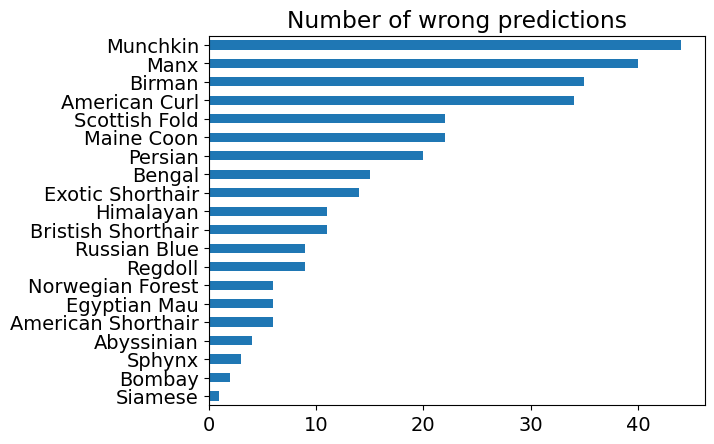

In [23]:
error_predictions_df.T.number_of_error.sort_values().plot.barh(title='Number of wrong predictions');

### Create matrix displaying the pred_classnames for each true_classname

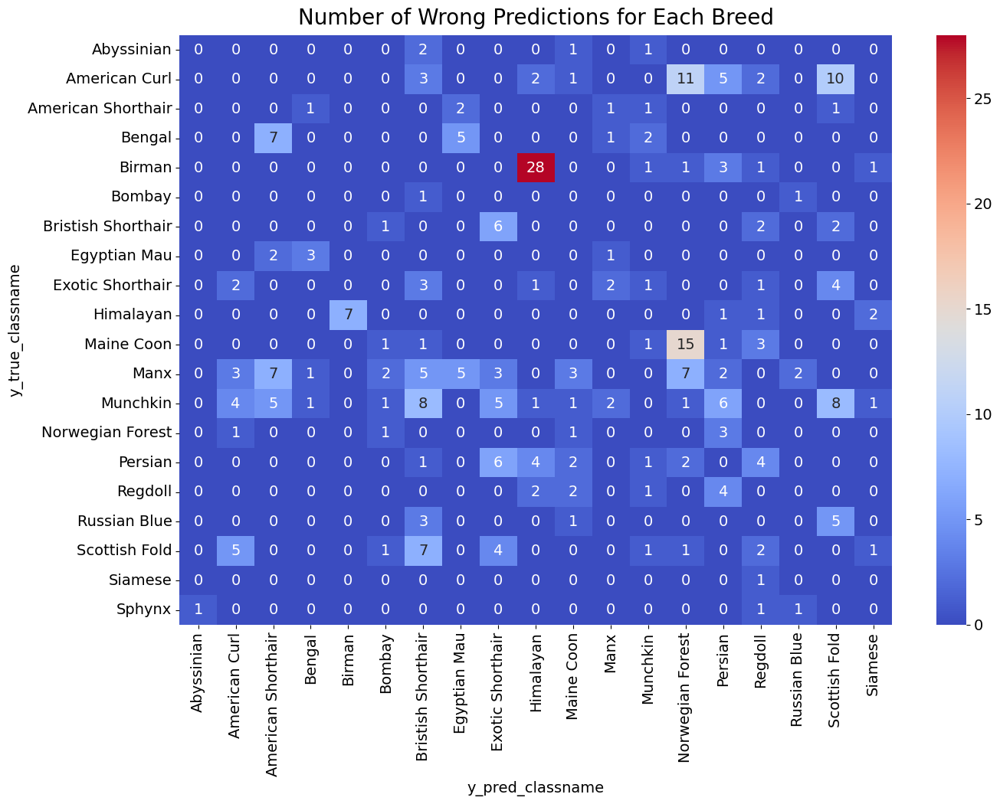

In [24]:
fig, ax = plt.subplots(figsize=(15, 10))
sns.heatmap(pd.crosstab(wrong_preds_df.y_true_classname, wrong_preds_df.y_pred_classname), annot=True, cmap='coolwarm', ax=ax)
ax.set_title('Number of Wrong Predictions for Each Breed', fontsize=20, pad=10)
plt.show()

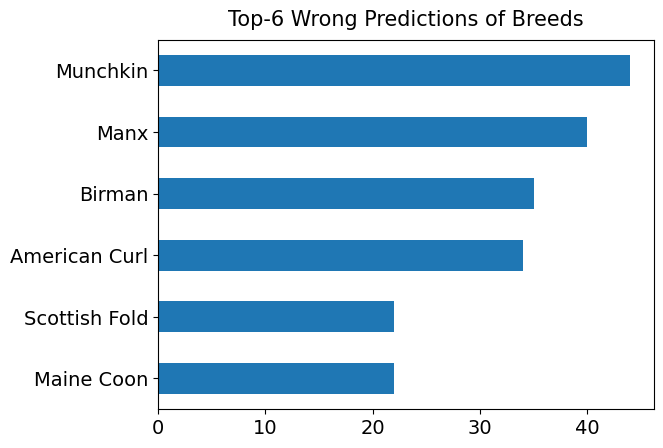

In [26]:
# Total number of error prediction over 75% (Q3)
seventy_fifth_percent_of_error = error_predictions_df.T.describe().T['75%'].values[0]
error_predicted_cat_breeds_df = error_predictions_df.T[error_predictions_df.T.number_of_error >= seventy_fifth_percent_of_error].number_of_error
error_predicted_cat_breeds = list(error_predicted_cat_breeds_df.index)

# Plot results
error_predicted_cat_breeds_df.sort_values().plot.barh()
plt.title('Top-6 Wrong Predictions of Breeds', fontsize=15, pad=10)
plt.show()

In [27]:
print(f"Top-6 Wrong Predictions of Breeds\n{error_predicted_cat_breeds}")

Top-6 Wrong Predictions of Breeds
['American Curl', 'Birman', 'Maine Coon', 'Manx', 'Munchkin', 'Scottish Fold']


In [28]:
# Unit breed that wrong prediction over 10
deleted_cats = []
for row in pd.crosstab(wrong_preds_df.y_true_classname, wrong_preds_df.y_pred_classname).iterrows():
  for error_pred_num in row[1].values:
    if error_pred_num >= 10:
      deleted_cats.append(row[0])

print(f"Number Greater and Equal than 10 of Wrong Predictions of Each Breed\n{deleted_cats}")

Number Greater and Equal than 10 of Wrong Predictions of Each Breed
['American Curl', 'American Curl', 'Birman', 'Maine Coon']


In [29]:
# Collect all the cats needed to be deleted
deleted_cats.extend(error_predicted_cat_breeds)
deleted_cats = np.unique(deleted_cats)

deleted_cats

array(['American Curl', 'Birman', 'Maine Coon', 'Manx', 'Munchkin',
       'Scottish Fold'], dtype='<U13')

### ✨ Observations ✨

As we can see that there are main 5 classes difficult to be classified by models, they are `American Curl`, `Birman`, `Manx`, `Munchkin`, and `Maine Coon` respectively.

- `American Curl`, `Manx`, and `Munchkin` can easily be mistaken for other breed of cats, it is probably that not the appearance but also  hair colors these cats have are various, hence, their characteristics model learned to are easily same to others (see the figures in following cells).


- As for `Birman` and `Maine Coon`, we can see that many times model would mistake `Birman` for `Himalayan` and  `Maine Coon` for `Norwegian Forest`, so after checking both the images I think I know why... `Birman` have a very similar patch of black hair on their faces with `Himalayan`, and `Maine Coon` have similar hair style with `Norwegian Forest`.

📑 Based on these observations, I will delete `American Curl`, `Birman`, `Maine Coon`, `Manx`, `Munchkin`, and `Bengal` that model easily mistakes to.

In [30]:
deleted_cats

array(['American Curl', 'Birman', 'Maine Coon', 'Manx', 'Munchkin',
       'Scottish Fold'], dtype='<U13')

### Show the cats expected to be deleted

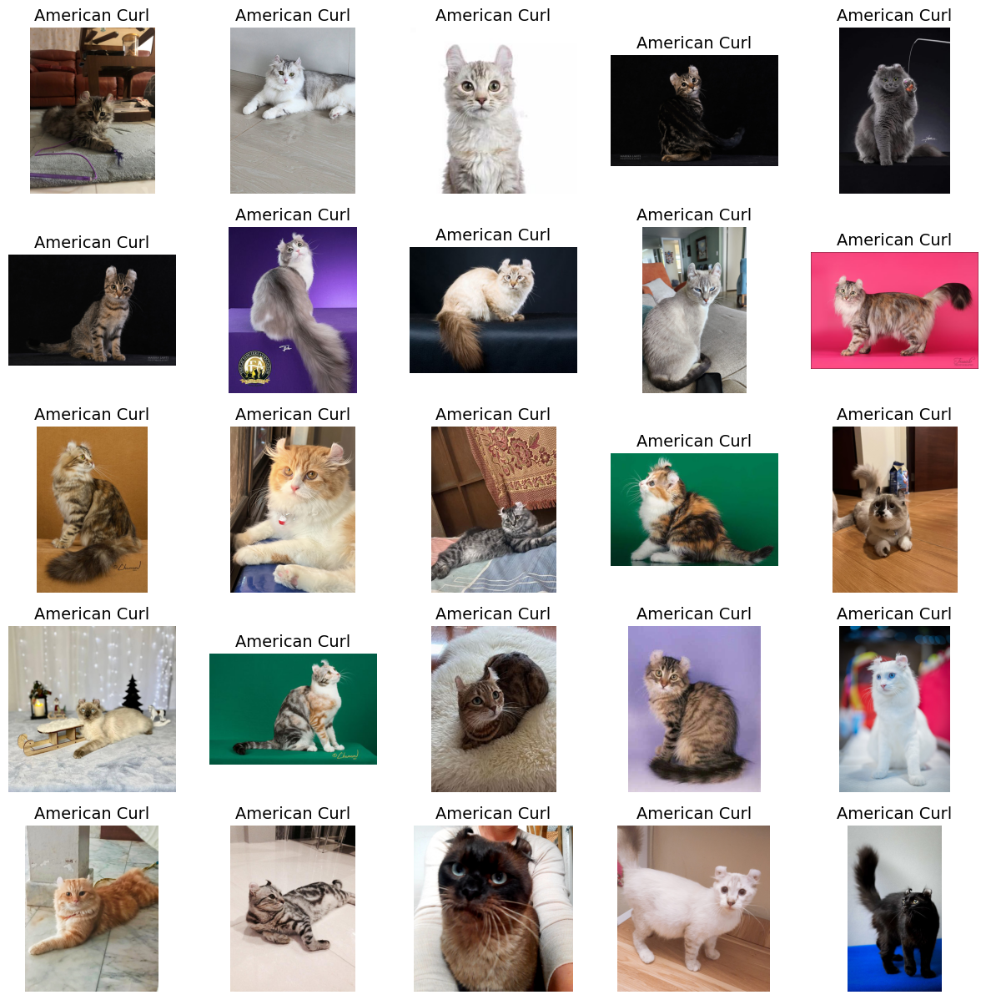

In [31]:
# American Curl
data_processor.show_25_images_from_dataset(images_dict['American Curl'])

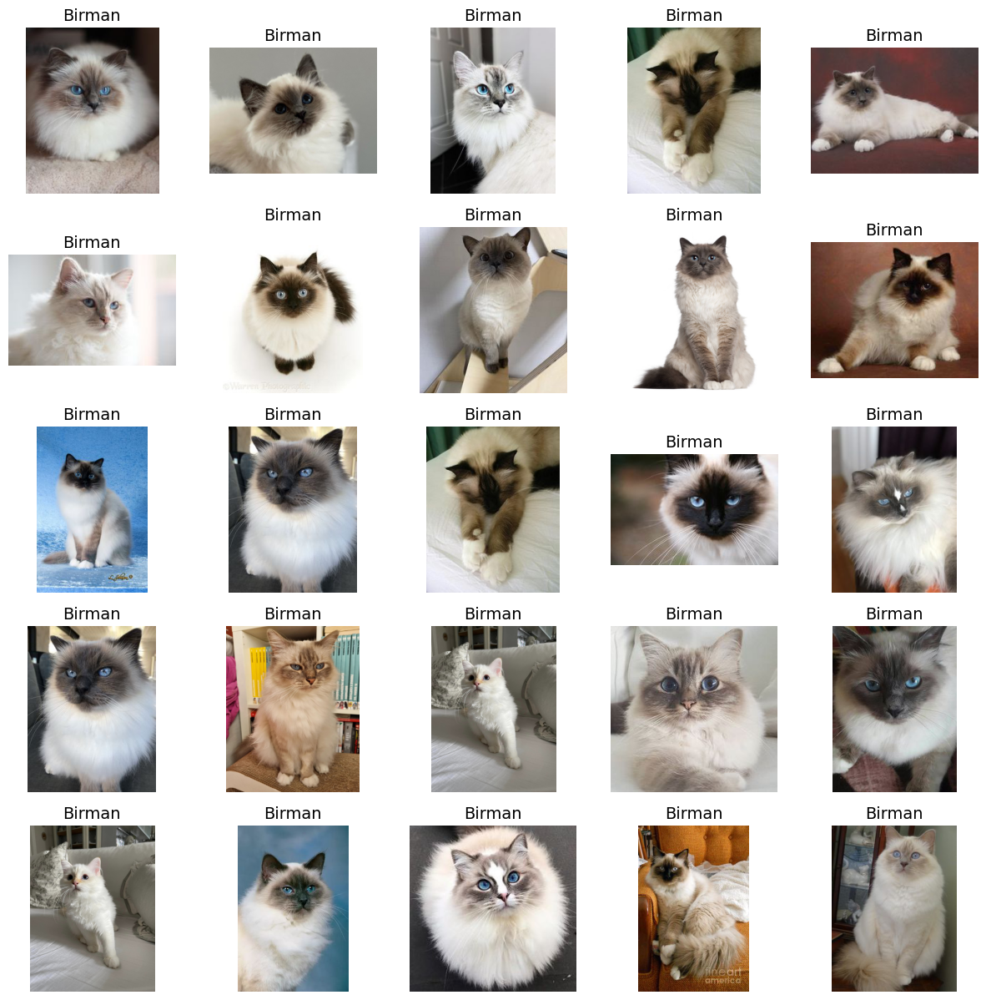

In [32]:
# Birman
data_processor.show_25_images_from_dataset(images_dict['Birman'])

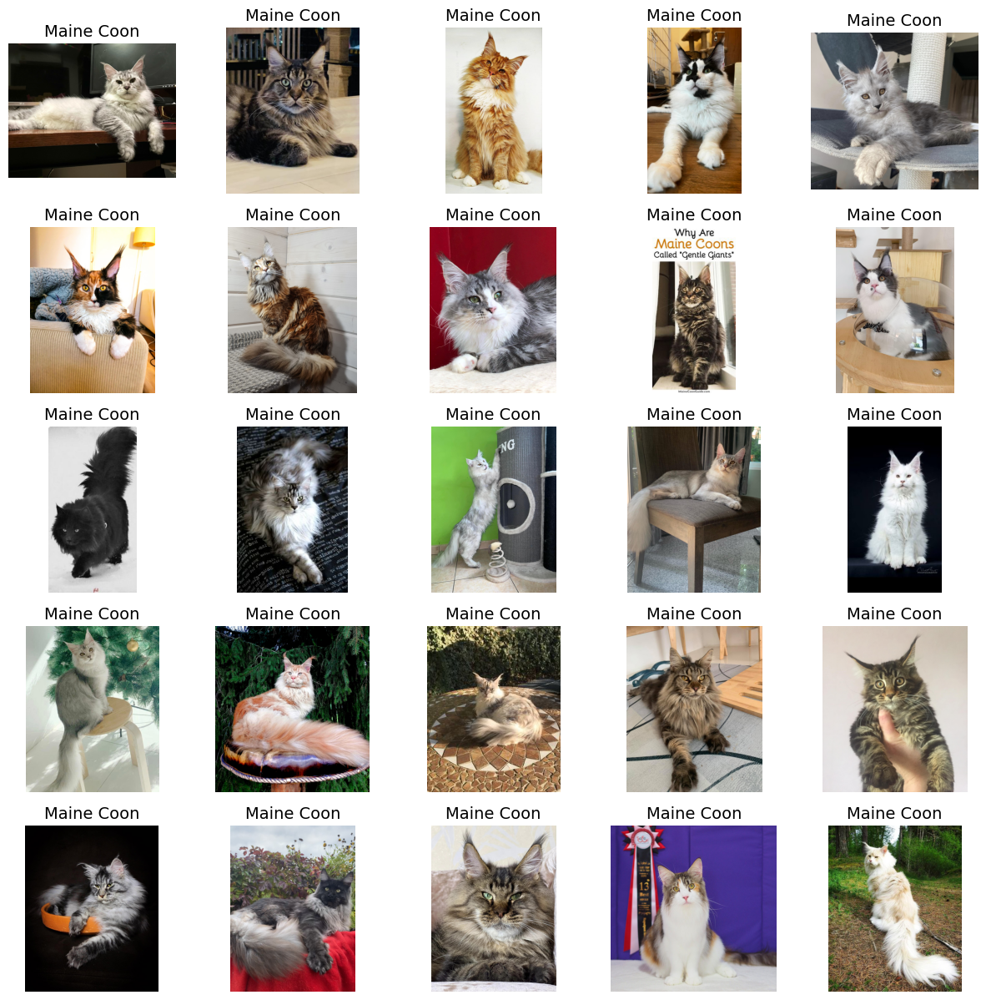

In [33]:
# Maine Coon
data_processor.show_25_images_from_dataset(images_dict['Maine Coon'])

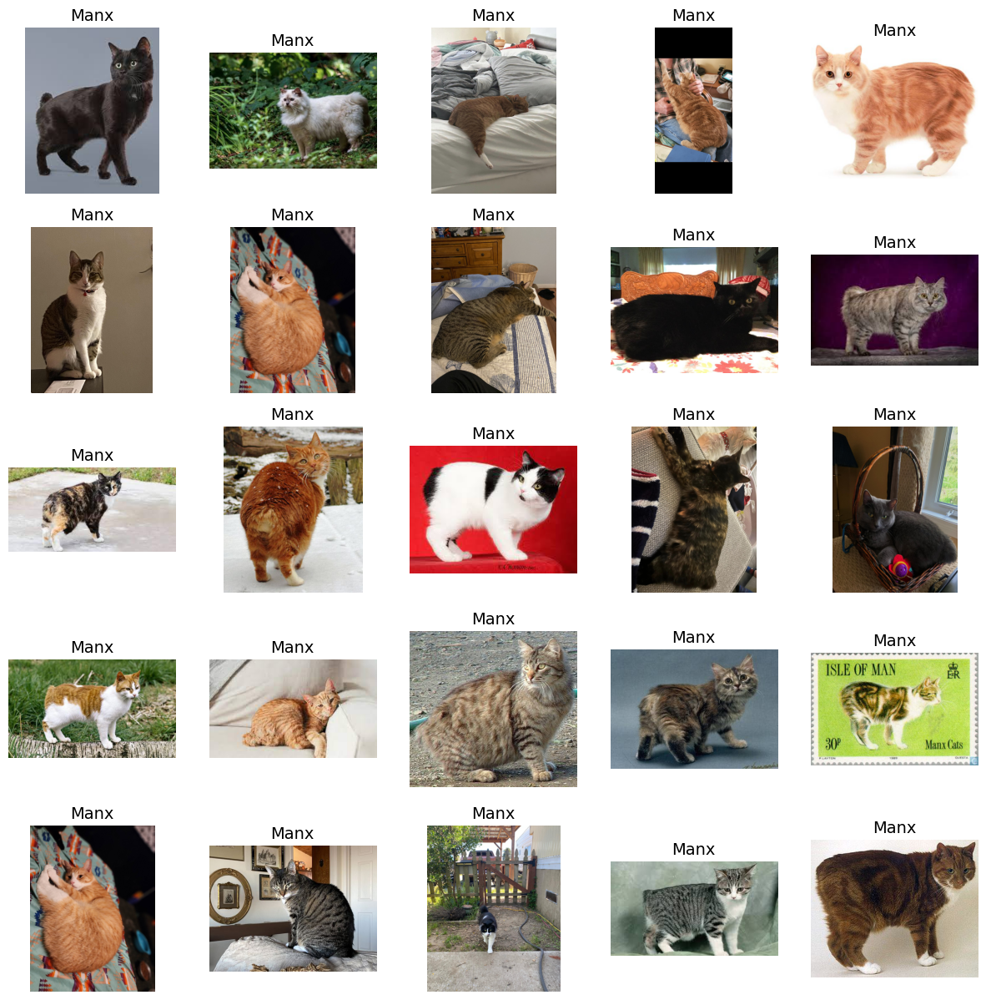

In [34]:
# Manx
data_processor.show_25_images_from_dataset(images_dict['Manx'])

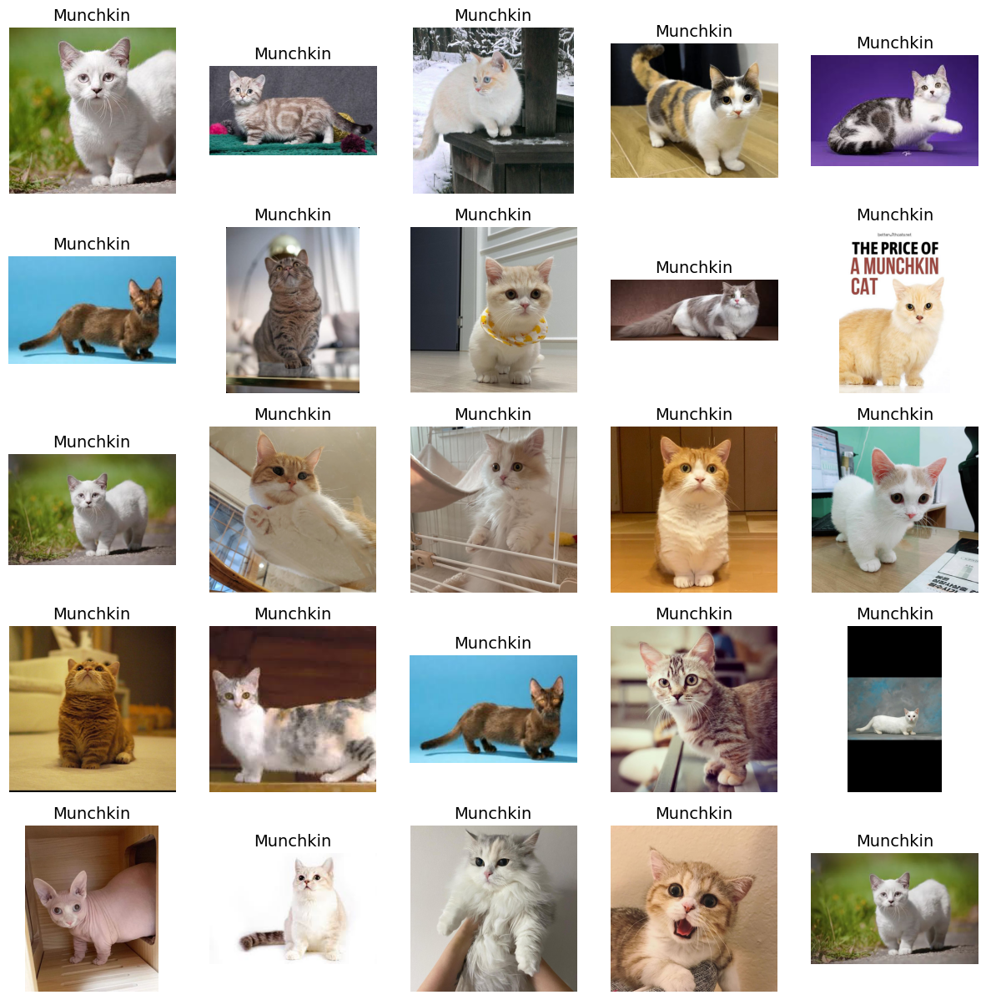

In [35]:
# Munchkin
data_processor.show_25_images_from_dataset(images_dict['Munchkin'])

## 4️⃣ >> Delete several classes and modify training conditions

In this part I will delete several classes abd retrain the model with data augmentation and fine-tune.

My augmentation conditions
1. Random Flip: **horizontal
2. Random Rotation: **0.2**
3. Random Zoom: **0.2**
4. Random Height: **0.2**
5. Random Width: **0.2**
6. Random Contrast: **0.5**


My training conditions

| Hyperparameters | Values |
| :-------------: | :----: |
| input shape | (224, 224, 3) |
| output shape | 14 (cat breeds) |
| activation function (last layer) | softmax |
| epochs for **training** | 5 |
| epochs for **fine-tune** | 3 |
| batch size | 32 |
| learning rate for **training** | $10^{-3}$ |
| learning rate for **fine-tunie** | $10^{-4}$ |
| loss function| categorical crossentropy |
| optimizer | Adam |

### Delete breeds difficult to classify

In [36]:
data_processor.home_path, deleted_cats

('./cats20',
 array(['American Curl', 'Birman', 'Maine Coon', 'Manx', 'Munchkin',
        'Scottish Fold'], dtype='<U13'))

In [38]:
for class_name in deleted_cats:
  train_dir = os.path.join(data_processor.home_path, 'train', class_name)
  test_dir = os.path.join(data_processor.home_path, 'test', class_name)
  for dir in [train_dir, test_dir]:
    for image in os.listdir(dir):
      image_deleted = os.path.join(dir, image)
      os.remove(image_deleted)
    os.rmdir(dir)
  print(f'{class_name} folder deleted')

American Curl folder deleted
Birman folder deleted
Maine Coon folder deleted
Manx folder deleted
Munchkin folder deleted
Scottish Fold folder deleted


### Create data batches from directory

Create training, validation, and testing datasets.

|               | Training data | Validation data | Testing data |
| ------------- | ------------- | --------------- | ------------ |
| Splitting Ratio | ~70% | ~8% | ~22% |

In [41]:
data_processor.home_path = './cats20/train/'
# Get the class names
data_processor.get_class_names()
class_names = data_processor.class_names

# Set random seed
seed = 42
np.random.seed(seed=seed)

# Read data again
images_dict = data_processor.read_acceptable_data(train_test_split=True)
print()
img_size = data_processor.IMG_SIZE
train_dataset, val_dataset, test_dataset = data_processor.create_data_batches_from_directory(IMG_SIZE=img_size)
print()
train_dataset.element_spec, val_dataset.element_spec, test_dataset.element_spec, img_size

There are 14 classes:
 ['Abyssinian', 'American Shorthair', 'Bengal', 'Bombay', 'Bristish Shorthair', 'Egyptian Mau', 'Exotic Shorthair', 'Himalayan', 'Norwegian Forest', 'Persian', 'Regdoll', 'Russian Blue', 'Siamese', 'Sphynx']
images_dict has been created.

Found 5052 files belonging to 14 classes.
Using 4547 files for training.
Found 5052 files belonging to 14 classes.
Using 505 files for validation.
Found 1400 files belonging to 14 classes.



((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 14), dtype=tf.float32, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 14), dtype=tf.float32, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 14), dtype=tf.float32, name=None)),
 224)

### Final model training

Image size: 224
Input shape: (224, 224, 3)
output shape: 14



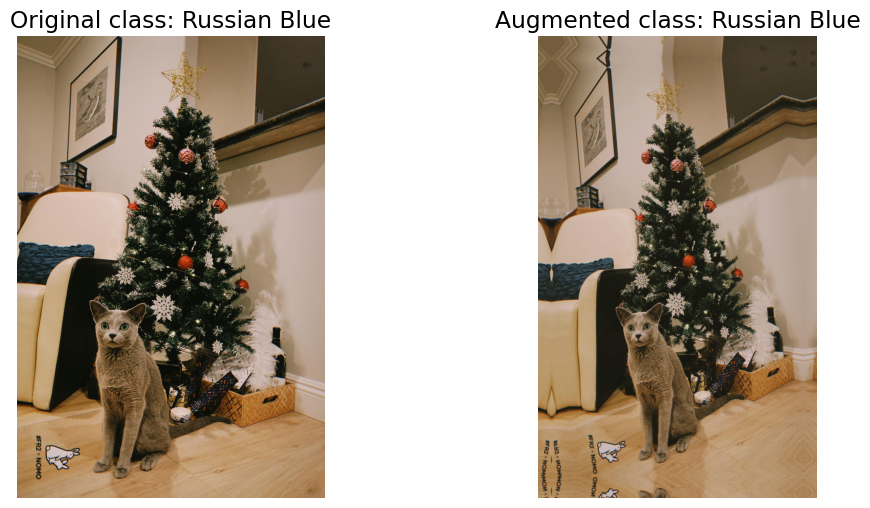


Model: "EfficientNetV2B0"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer_2 (InputLayer)  [(None, 224, 224, 3)]     0         
                                                                 
 data_augmentation_2 (Sequen  (None, 224, 224, 3)      0         
 tial)                                                           
                                                                 
 efficientnetv2-b0 (Function  (None, None, None, 1280)  5919312  
 al)                                                             
                                                                 
 global_average_pooling_2 (G  (None, 1280)             0         
 lobalAveragePooling2D)                                          
                                                                 
 output_layer_2 (Dense)      (None, 14)                17934     
                                                 

In [42]:
# Train checkpoint model
from tensorflow.keras.applications.efficientnet_v2 import EfficientNetV2B0
from tensorflow.keras.applications.efficientnet_v2 import preprocess_input as effv2_preprocess_input

# Set images parameters
final_model = ModelTrainer(
    IMG_SIZE=img_size,
    train_dataset=train_dataset,
    val_dataset=val_dataset,
    test_dataset=test_dataset,
    classes=len(class_names),
    handle_number=handle_number)
print()

# show image after augmentation

# Choose image
images_list = data_processor.get_images_list()
random_image_path = random.choice(images_list)
target_class = random_image_path.split('\\')[-2]

# Output image
plt.figure(figsize=(12, 6))
plt.subplot(121)
img = mpimg.imread(random_image_path)
plt.imshow(img)
plt.title(f"Original class: {target_class}")
plt.axis("off")

# The format after augmentation must be (None, height, width, 3)
plt.subplot(122)
data_augmentation = final_model._data_augmentation()
augmented_img = data_augmentation(tf.expand_dims(img, axis=0), training=True)
plt.imshow(tf.squeeze(augmented_img) / 255.0) # normalization
plt.title(f"Augmented class: {target_class}")
plt.axis("off")
plt.show()
print()

# Build model
base_model = EfficientNetV2B0(include_top=False)
final_model.build_model(base_model=base_model, preprocess_input=effv2_preprocess_input, model_name='EfficientNetV2B0')
final_model.compile()
final_model_history = final_model.fit_model(epochs=5)
final_model_results = final_model.evaluate_model()
print(final_model_results)

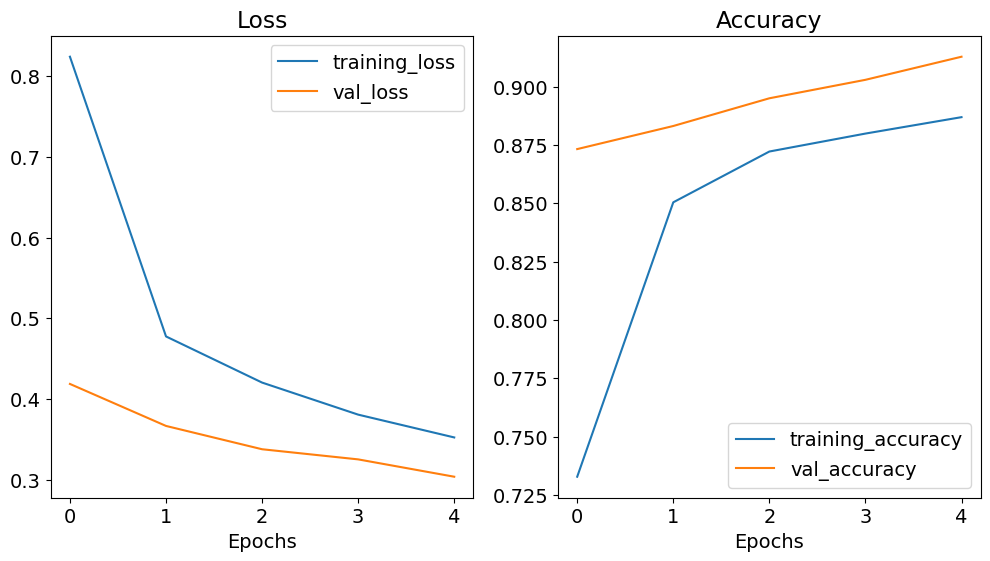

In [43]:
final_model.plot_loss_curves()

In [44]:
# Fine-tuning model for 3% parameters
final_model.fine_tune_model_layers(fine_tune_ratio=0.03)

# Recompile is necessary after fine-tuning
final_model.compile(optimizer=tf.keras.optimizers.Adam(1e-4))

# Fir the model
final_model_history_fine_tune = final_model.fit_model(epochs=8, fine_tune_epochs=3)

# Evaluate the model
final_model_fine_tune_results = final_model.evaluate_model()

Change last 7 layers of efficientnetv2-b0 successfully, please recompile model again.
Epoch 6/8


143/143 [==============================] - 227s 2s/step - loss: 0.3197 - accuracy: 0.8997 - val_loss: 0.2534 - val_accuracy: 0.9188
Epoch 7/8
143/143 [==============================] - 229s 2s/step - loss: 0.2768 - accuracy: 0.9087 - val_loss: 0.2469 - val_accuracy: 0.9228
Epoch 8/8
44/44 [==============================] - 51s 1s/step - loss: 0.2044 - accuracy: 0.9393


In [45]:
print(final_model_fine_tune_results)

[0.20436085760593414, 0.9392856955528259]


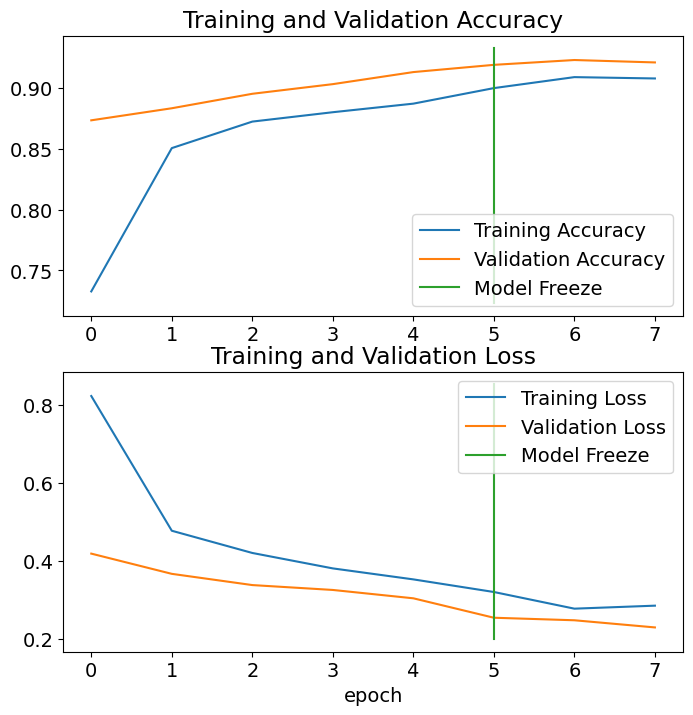

In [46]:
final_model.compare_historys()

As we can see that the accuracy of model achieves 90% after deleting several classes difficult to classify. Moreover, the performance of model further improves with fin-tuning operation, let's save the model and apply it to something cool !

### Save the final model

In [47]:
final_model.save_model(model_dir=root_dir+'/', suffix='cat_breed_fine_tune_classifier')

Saving model to: c:\Users\User\Desktop\Data_Science_Notebook\Done__20_Cats_Project/_cat_breed_fine_tune_classifier.h5...
Saving labels to "labels.txt" ...


'c:\\Users\\User\\Desktop\\Data_Science_Notebook\\Done__20_Cats_Project/_cat_breed_fine_tune_classifier.h5'

In [48]:
final_model_loaded = final_model.load_model(final_model.model_save_path)

Loading saved model from: c:\Users\User\Desktop\Data_Science_Notebook\Done__20_Cats_Project/_cat_breed_fine_tune_classifier.h5


## 5️⃣ >> Applying model to do some recognitions.

In the final proportion of project, I will apply my pre-trained model for two things:

1. Predict my custom images that model never sees them.

2. Filter the right wrong images while crawling lovely-cat pictures from google search images.

### 🎉Predict custom images

In [49]:
# Model class labels
label_names = load_labels()

label_names

Loading class names from labels.txt
OK


['Abyssinian',
 'American Shorthair',
 'Bengal',
 'Bombay',
 'Bristish Shorthair',
 'Egyptian Mau',
 'Exotic Shorthair',
 'Himalayan',
 'Norwegian Forest',
 'Persian',
 'Regdoll',
 'Russian Blue',
 'Siamese',
 'Sphynx']

In [50]:
# Collect custom images
custom_class_images = {}

for cat_breed in os.listdir(os.path.join(root_dir, 'custom_cats_images')):
  cat_img_path = os.path.join(root_dir, 'custom_cats_images', cat_breed)
  custom_cat_images = []
  for cat_img in os.listdir(cat_img_path):
    cat_img = os.path.join(cat_img_path, cat_img)
    custom_cat_images.append(cat_img)
  custom_class_images[cat_breed] = custom_cat_images

custom_class_images[random.choice(list(custom_class_images.keys()))][:5]

['c:\\Users\\User\\Desktop\\Data_Science_Notebook\\Done__20_Cats_Project\\custom_cats_images\\Abyssinian\\crawl_Abyssinian_1.jpg',
 'c:\\Users\\User\\Desktop\\Data_Science_Notebook\\Done__20_Cats_Project\\custom_cats_images\\Abyssinian\\crawl_Abyssinian_10.jpg',
 'c:\\Users\\User\\Desktop\\Data_Science_Notebook\\Done__20_Cats_Project\\custom_cats_images\\Abyssinian\\crawl_Abyssinian_11.jpg',
 'c:\\Users\\User\\Desktop\\Data_Science_Notebook\\Done__20_Cats_Project\\custom_cats_images\\Abyssinian\\crawl_Abyssinian_12.jpg',
 'c:\\Users\\User\\Desktop\\Data_Science_Notebook\\Done__20_Cats_Project\\custom_cats_images\\Abyssinian\\crawl_Abyssinian_13.jpg']

In [40]:
# # Load pre-trained model
# model_dir = os.path.join(root_dir, '_cat_breed_fine_tune_classifier.h5')
# final_model_loaded = tf.keras.models.load_model(model_dir)

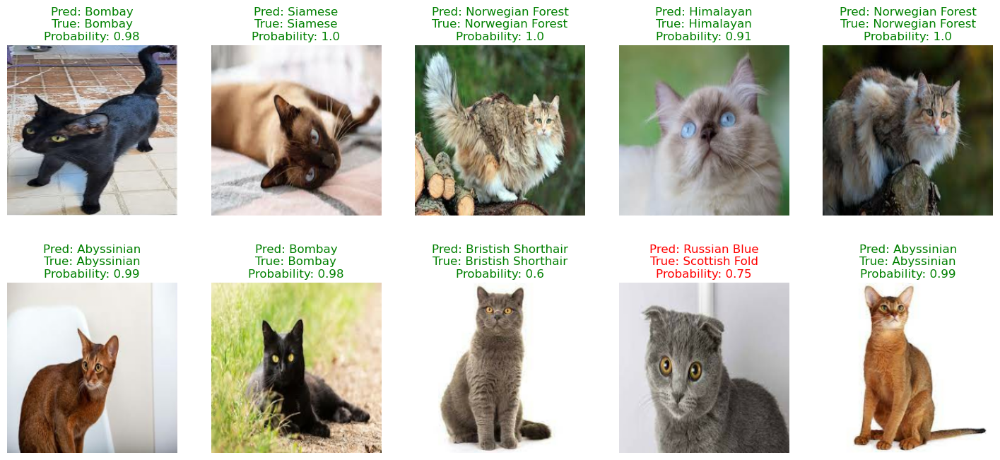

In [52]:
# Plot predicted results
plt.figure(figsize=(18, 8))
for i in range(10):
  # Choose images
  custom_label = random.choice(list(custom_class_images.keys()))
  custom_image = random.choice(custom_class_images[custom_label])
  custom_image = load_and_prep_image(custom_image, scale=False)
  custom_image = tf.expand_dims(custom_image, axis=0)

  # Model prediction
  pred_prob = final_model_loaded.predict(custom_image)
  pred_label = label_names[pred_prob.argmax()]

  # Title color difference depends on prediction results
  color = 'green' if (custom_label == pred_label) else 'red'

  # Plot results
  plt.subplot(2, 5, i+1)
  plt.imshow(tf.squeeze(custom_image)/255.)
  plt.axis('off')
  img_prob = np.round(pred_prob.max(), 2).astype(str)
  plt.title(f"Pred: {pred_label}\nTrue: {custom_label}\nProbability: {img_prob}", color=color, fontsize=12)
plt.show()

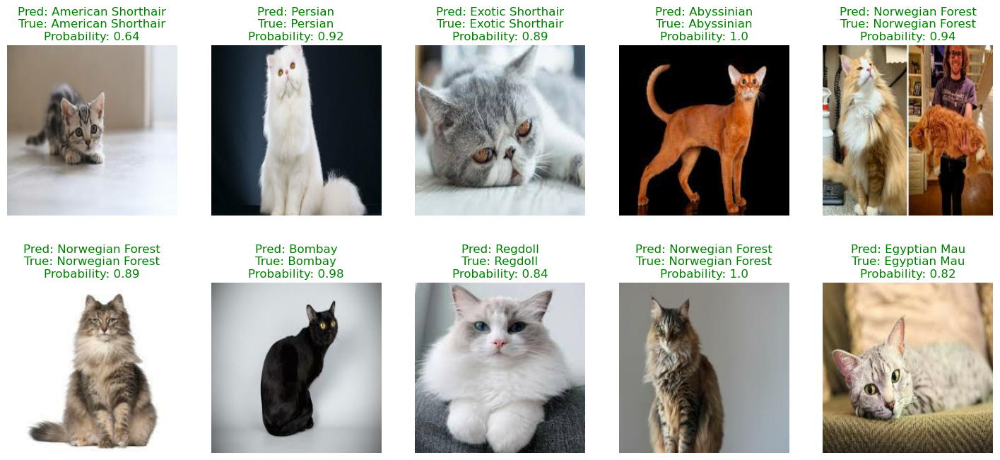

In [145]:
# Plot predicted results
plt.figure(figsize=(18, 8))
for i in range(10):
  # Choose images
  custom_label = random.choice(list(custom_class_images.keys()))
  custom_image = random.choice(custom_class_images[custom_label])
  custom_image = load_and_prep_image(custom_image, scale=False)
  custom_image = tf.expand_dims(custom_image, axis=0)

  # Model prediction
  pred_prob = final_model_loaded.predict(custom_image)
  pred_label = label_names[pred_prob.argmax()]

  # Title color difference depends on prediction results
  color = 'green' if (custom_label == pred_label) else 'red'

  # Plot results
  plt.subplot(2, 5, i+1)
  plt.imshow(tf.squeeze(custom_image)/255.)
  plt.axis('off')
  img_prob = np.round(pred_prob.max(), 2).astype(str)
  plt.title(f"Pred: {pred_label}\nTrue: {custom_label}\nProbability: {img_prob}", color=color, fontsize=12)
plt.show()

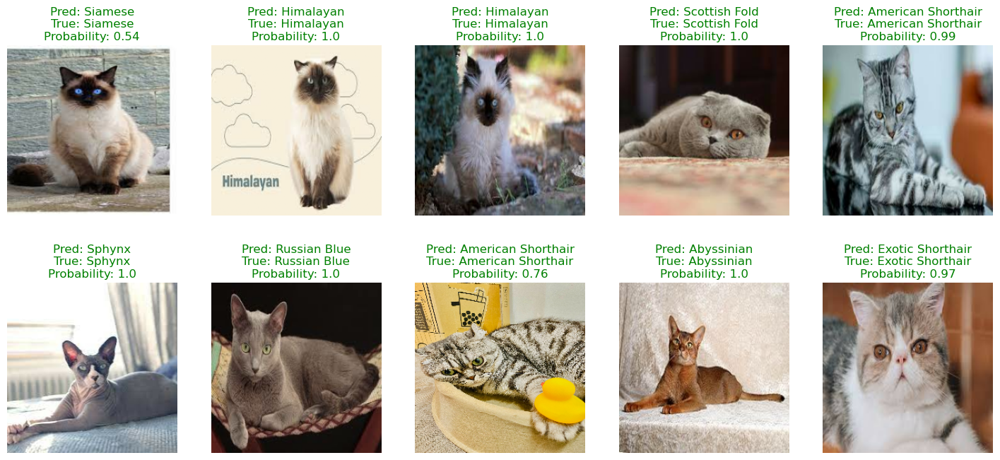

In [148]:
# Plot predicted results
plt.figure(figsize=(18, 8))
for i in range(10):
  # Choose images
  custom_label = random.choice(list(custom_class_images.keys()))
  custom_image = random.choice(custom_class_images[custom_label])
  custom_image = load_and_prep_image(custom_image, scale=False)
  custom_image = tf.expand_dims(custom_image, axis=0)

  # Model prediction
  pred_prob = final_model_loaded.predict(custom_image)
  pred_label = label_names[pred_prob.argmax()]

  # Title color difference depends on prediction results
  color = 'green' if (custom_label == pred_label) else 'red'

  # Plot results
  plt.subplot(2, 5, i+1)
  plt.imshow(tf.squeeze(custom_image)/255.)
  plt.axis('off')
  img_prob = np.round(pred_prob.max(), 2).astype(str)
  plt.title(f"Pred: {pred_label}\nTrue: {custom_label}\nProbability: {img_prob}", color=color, fontsize=12)
plt.show()

### 🎊 Filter crawling images.

In [114]:
from my_packages.image_crawling import cat_image_crawler

In [115]:
my_webdriver_path = 'C:/Users/User/chromedriver-win64/chromedriver-win64/chromedriver.exe'

In [116]:
cat_crawler = cat_image_crawler.CatImageCrawler(service=my_webdriver_path, home_dir='./cats20')

Set successfully as ./cats20
CatImageFileOperator object has built.


In [117]:
label_names

['Abyssinian',
 'American Shorthair',
 'Bombay',
 'Bristish Shorthair',
 'Egyptian Mau',
 'Exotic Shorthair',
 'Himalayan',
 'Norwegian Forest',
 'Persian',
 'Regdoll',
 'Russian Blue',
 'Scottish Fold',
 'Siamese',
 'Sphynx']

In [118]:
cat_crawler.crawling_from_google_images(image_number=20, data=label_names)

Searching Abyssinian ...
Download 27 images...
Abyssinian Finish, total images: 27
Searching American Shorthair ...
Download 26 images...
American Shorthair Finish, total images: 26
Searching Bombay ...
Download 24 images...
Bombay Finish, total images: 24
Searching Bristish Shorthair ...
Download 24 images...
Bristish Shorthair Finish, total images: 24
Searching Egyptian Mau ...
Download 30 images...
Egyptian Mau Finish, total images: 30
Searching Exotic Shorthair ...
Download 27 images...
Exotic Shorthair Finish, total images: 27
Searching Himalayan ...
Download 26 images...
Himalayan Finish, total images: 26
Searching Norwegian Forest ...
Download 29 images...
Norwegian Forest Finish, total images: 29
Searching Persian ...
Download 25 images...
Persian Finish, total images: 25
Searching Regdoll ...
Download 25 images...
Regdoll Finish, total images: 25
Searching Russian Blue ...
Download 27 images...
Russian Blue Finish, total images: 27
Searching Scottish Fold ...
Download 24 image

During image crawling, my folder will generate new folder of which folder name is same with original one with `__crawl` suffix addition.

```
Main-directory
  |
  |___American Curl
  |________class_a_image_1
  |________class_a_image_2
  |
  |___American Curl_crawl
  |________class_b_image_1_crawl
  |________class_b_image_2_crawl
  |
  |... (other breeds)
```

In [119]:
# Filter the images

# Images collection
home_path = './cats20'
target_folders = [target_folder.name for target_folder in Path(home_path).glob('*_crawl')]
images_removed = []
images_accepted = []
print(target_folders)

# Walk the crawled images and predict them
for target_folder in target_folders:
  cat_path_sudir = os.path.join(home_path, target_folder)
  for cat_image in os.listdir(cat_path_sudir):
    cat_image_path = os.path.join(cat_path_sudir, cat_image)
    true_label = target_folder.split('_')[0] # true label
    custom_image = load_and_prep_image(cat_image_path, scale=False)
    custom_image = tf.expand_dims(custom_image, axis=0)
    pred_prob = final_model_loaded.predict(custom_image) # model prediction
    pred_label = label_names[pred_prob.argmax()] # predicted result

    if pred_label != true_label:
      images_removed.append(cat_image_path)
    else:
      images_accepted.append(cat_image_path)

images_removed[:10], images_accepted[:10]

['Abyssinian_crawl', 'American Shorthair_crawl', 'Bombay_crawl', 'Bristish Shorthair_crawl', 'Egyptian Mau_crawl', 'Exotic Shorthair_crawl', 'Himalayan_crawl', 'Norwegian Forest_crawl', 'Persian_crawl', 'Regdoll_crawl', 'Russian Blue_crawl', 'Scottish Fold_crawl', 'Siamese_crawl', 'Sphynx_crawl']


(['./cats20\\American Shorthair_crawl\\crawl_American Shorthair_14.jpg',
  './cats20\\American Shorthair_crawl\\crawl_American Shorthair_20.jpg',
  './cats20\\American Shorthair_crawl\\crawl_American Shorthair_5.jpg',
  './cats20\\American Shorthair_crawl\\crawl_American Shorthair_6.jpg',
  './cats20\\American Shorthair_crawl\\crawl_American Shorthair_7.jpg',
  './cats20\\Bombay_crawl\\crawl_Bombay_22.jpg',
  './cats20\\Bristish Shorthair_crawl\\crawl_Bristish Shorthair_10.jpg',
  './cats20\\Bristish Shorthair_crawl\\crawl_Bristish Shorthair_11.jpg',
  './cats20\\Bristish Shorthair_crawl\\crawl_Bristish Shorthair_12.jpg',
  './cats20\\Bristish Shorthair_crawl\\crawl_Bristish Shorthair_13.jpg'],
 ['./cats20\\Abyssinian_crawl\\crawl_Abyssinian_1.jpg',
  './cats20\\Abyssinian_crawl\\crawl_Abyssinian_10.jpg',
  './cats20\\Abyssinian_crawl\\crawl_Abyssinian_11.jpg',
  './cats20\\Abyssinian_crawl\\crawl_Abyssinian_12.jpg',
  './cats20\\Abyssinian_crawl\\crawl_Abyssinian_13.jpg',
  './cats20\

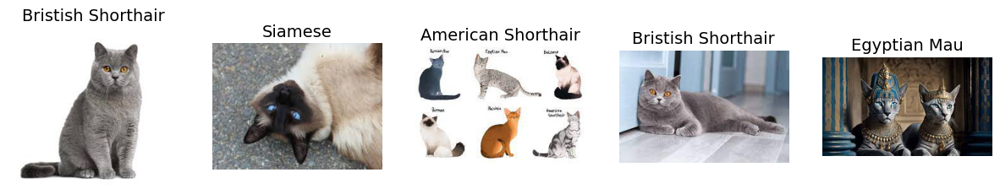

In [132]:
# Show the filtered pictures
plt.figure(figsize=(15, 5))
for i in range(5):
  cat_img = random.choice(images_removed)
  label = cat_img.split('_')[-2]
  plt.subplot(1, 5, i + 1)
  img = plt.imread(cat_img)
  plt.imshow(img)
  plt.title(label, fontsize=14)  
  plt.axis("off")

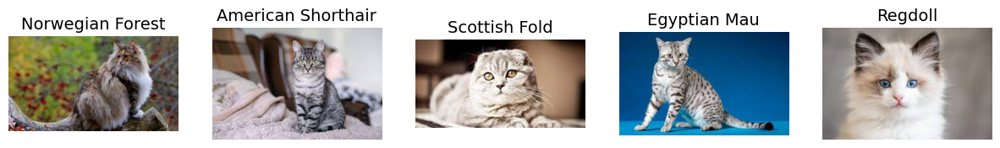

In [134]:
# Show the passed images
plt.figure(figsize=(15, 5))
for i in range(5):
  cat_img = random.choice(images_accepted)
  label = cat_img.split('_')[-2]
  plt.subplot(1, 5, i + 1)
  img = plt.imread(cat_img)
  plt.imshow(img)
  plt.title(label, fontsize=14)  
  plt.axis("off")

In [135]:
# Remove the unacceptable images
for image_removed in images_removed:
  os.remove(image_removed)
print("OK")

OK


In [136]:
# Combine the crawled images and original images
cat_crawler.combine_folders_from_suffix()

Move files from [cats20\Abyssinian_crawl] to ['Abyssinian']...
Delete cats20\Abyssinian_crawl...
Move files from [cats20\American Shorthair_crawl] to ['American Shorthair']...
Delete cats20\American Shorthair_crawl...
Move files from [cats20\Bombay_crawl] to ['Bombay']...
Delete cats20\Bombay_crawl...
Move files from [cats20\Bristish Shorthair_crawl] to ['Bristish Shorthair']...
Delete cats20\Bristish Shorthair_crawl...
Move files from [cats20\Egyptian Mau_crawl] to ['Egyptian Mau']...
Delete cats20\Egyptian Mau_crawl...
Move files from [cats20\Exotic Shorthair_crawl] to ['Exotic Shorthair']...
Delete cats20\Exotic Shorthair_crawl...
Move files from [cats20\Himalayan_crawl] to ['Himalayan']...
Delete cats20\Himalayan_crawl...
Move files from [cats20\Norwegian Forest_crawl] to ['Norwegian Forest']...
Delete cats20\Norwegian Forest_crawl...
Move files from [cats20\Persian_crawl] to ['Persian']...
Delete cats20\Persian_crawl...
Move files from [cats20\Regdoll_crawl] to ['Regdoll']...
Dele

End